# Задача 25: Задача классификации на данных Breast-cancer

## Импортируем необходимые библиотеки:

In [290]:
import numpy as np
import pandas as pd

import warnings
warnings.simplefilter('ignore')

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import scale
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV

from sklearn import metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from sklearn.utils.fixes import signature

from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn import linear_model

from sklearn.feature_selection import SelectKBest, chi2
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap as UMAP
from sklearn.feature_selection import RFE


import seaborn as sns; sns.set(style="ticks", color_codes=True)
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import ListedColormap
from sklearn import datasets 


%matplotlib inline
#%config InlineBackend.figure_format = 'svg'

## Создадим две функции:

### 1. Функцию отслеживания ошибок алгоритма:

In [264]:
def control_error(X_train, y_train, X_test, y_test, model, all_data = [], all_y = [], k_fold = 0, with_graph = False, inf = 'small'): #useful, you can look on all error
    from sklearn.metrics import accuracy_score
    from sklearn.metrics import roc_auc_score
    #from sklearn.metrics import precision_score
    #from sklearn.metrics import recall_score
    
    if (inf == 'small') | (inf == 'large') | (inf == 'cross_val') | (inf == 'cross_val_and_large'):
    
        y_predict = model.predict(X_test)
        y_predict_proba = (model.predict_proba(X_test))[:,1]
        y_predict_proba_train = (model.predict_proba(X_train))[:,1]
    
        print '\n <------------------------------------------------------------> \n'
        print '                  Accuracy on the test:', round(accuracy_score(y_test, y_predict),3)
        print '                  ROC-AUC on the test:',  round(roc_auc_score(y_test, y_predict_proba),3)
        print '                     PR on the test:',  round(average_precision_score(y_test, y_predict_proba),3)
        print '\n |------------------------------------------------------------| \n'
    
        y_test_0 = y_test[y_test == 0]
        y_test_1 = y_test[y_test == 1]
        X_test_0 = X_test[y_test == 0]
        X_test_1 = X_test[y_test == 1]
        
        if (inf == 'cross_val') | (inf == 'cross_val_and_large'):
            if len(all_data) == 0:
                print 'You forgot data\n'
                return
            if k_fold == 0:
                print 'You forgot fold\n'
                return
            if len(all_y) == 0:
                print 'You forgot y\n'
                return
            skf = StratifiedKFold(n_splits=k_fold, shuffle =True)
            print '         Estimation of Accuracy by cross validation', round(np.mean(cross_val_score(model, all_data, all_y, scoring='accuracy', cv = skf.split(all_data, all_y))),3)
            print '          Estimation of ROC-AUC by cross validation', round(np.mean(cross_val_score(model, all_data, all_y, scoring='roc_auc', cv = skf.split(all_data, all_y))),3)
            print '         Estimation of average PR by cross validation', round(np.mean(cross_val_score(model, all_data, all_y, scoring='average_precision', cv = skf.split(all_data, all_y))),3)
            #print '         Estimation of precision by cross validation', round(np.mean(cross_val_score(model, all_data, all_y, scoring='precision', cv = skf.split(all_data, all_y))),3)
            #print '         Estimation of recall by cross validation', round(np.mean(cross_val_score(model, all_data, all_y, scoring='recall', cv = skf.split(all_data, all_y))),3)

            print '\n |------------------------------------------------------------| \n'
            
    
        print '               Accuracy on 0 class on test:', round(accuracy_score(y_test_0, model.predict(X_test_0)),3)
        print '               Accuracy on 1 class on test:', round(accuracy_score(y_test_1, model.predict(X_test_1)),3)
    
        if (inf == 'large') | (inf == 'cross_val_and_large'):
    
            print '\n |------------------------------------------------------------| \n'
    
            y_predict_train = model.predict(X_train)
    
            print '                  Accuracy on the train:', round(accuracy_score(y_train, y_predict_train),3)
            print '                  ROC-AUC on the train:', round(roc_auc_score(y_train, y_predict_proba_train),3)
            print '\n |------------------------------------------------------------| \n'
    
            y_train_0 = y_train[y_train == 0]
            y_train_1 = y_train[y_train == 1]
            X_train_0 = X_train[y_train == 0]
            X_train_1 = X_train[y_train == 1]
        
            print '               Accuracy on 0 class on train:', round(accuracy_score(y_train_0, model.predict(X_train_0)),3)
            print '               Accuracy on 1 class on train:', round(accuracy_score(y_train_1, model.predict(X_train_1)),3)
        
        print '\n <------------------------------------------------------------> \n'
    
        if with_graph == True:
        
            fig, (ax1,ax2) = plt.subplots(1,2,figsize=(10, 4))
        
            #----------------------------------------------------------------------------------
        
            fpr, tpr, _ = metrics.roc_curve(y_test,  y_predict_proba)
            auc = metrics.roc_auc_score(y_test, y_predict_proba)
            # In matplotlib < 1.5, plt.fill_between does not have a 'step' argument
            step_kwargs = ({'step': 'post'}
                            if 'step' in signature(ax1.fill_between).parameters
                            else {})

            ax1.step(fpr, tpr, color='b', alpha=0.2, where='post')
            ax1.fill_between(fpr, tpr, alpha=0.2, color='b', **step_kwargs)

            ax1.set_xlabel('False Positive Rate')
            ax1.set_ylabel('True Positive Rate')
            ax1.set_ylim([0.0, 1.05])
            ax1.set_xlim([0.0, 1.0])
            ax1.set_title('2-class ROC curve: ROC_AUC={0:0.2f}'.format(auc))

            #-----------------------------------------------------------------------------------

        
            precision, recall, _ = precision_recall_curve(y_test, y_predict_proba)
            average_precision = average_precision_score(y_test, y_predict_proba)
            # In matplotlib < 1.5, plt.fill_between does not have a 'step' argument
            step_kwargs = ({'step': 'post'}
                           if 'step' in signature(ax2.fill_between).parameters
                           else {})
            ax2.step(recall, precision, color='b', alpha=0.2, where='post')
            ax2.fill_between(recall, precision, alpha=0.2, color='b', **step_kwargs)

            ax2.set_xlabel('Recall')
            ax2.set_ylabel('Precision')
            ax2.set_ylim([0.0, 1.05])
            ax2.set_xlim([0.0, 1.0])
            ax2.set_title('2-class Precision-Recall curve: AP={0:0.2f}'.format(average_precision))
    
            #-----------------------------------------------------------------------------------
            plt.show()
            
        


### 2. Функцию прибавления случайного вектора к столбцам таблицы для визуализации:

In [265]:
def make_data_for_graph(data, ignored_col=[], dispersion = 0.05, mean_ = 'AVG'): #make randon vector and sum vector in DF
    columns = data.columns
    new_data = data.copy()
    
    for column in columns:
        
        if column in ignored_col:
            continue
        
        vec = np.array(data[column])
        
        if mean_ == 'AVG':
            mean = np.mean(vec)
        elif mean != 'AVG' :
            print 'not now'
            return data
        
        random_vec = (np.random.uniform(-mean*dispersion, mean*dispersion, size=(1, len(data))))[0]
        new_data[column] = pd.DataFrame(vec+random_vec)
        
        new_data.dropna(inplace = True)
    
    
    return new_data

## Рассмотрим данные, предложенные в задаче:

### Загрузим данные и посмотрим на них:

In [266]:
df_breast_cancer = pd.read_csv('breast-cancer.data',sep=',')
df_breast_cancer.head()

,Class,age,menopause,tumor-size,inv-nodes,node-caps,deg-malig,breast,breast-quad,irradiat
0,no-recurrence-events,30-39,premeno,30-34,0-2,no,3,left,left_low,no
1,no-recurrence-events,40-49,premeno,20-24,0-2,no,2,right,right_up,no
2,no-recurrence-events,40-49,premeno,20-24,0-2,no,2,left,left_low,no
3,no-recurrence-events,60-69,ge40,15-19,0-2,no,2,right,left_up,no
4,no-recurrence-events,40-49,premeno,0-4,0-2,no,2,right,right_low,no


#### Проверим, есть ли среди наших данных пропуски:

##### Проверим, есть ли в столбцах значения NaN:

In [267]:
df_breast_cancer.notnull().sum(axis=0) # проверям, что в столбцах нет пропусков

Class          286
age            286
menopause      286
tumor-size     286
inv-nodes      286
node-caps      286
deg-malig      286
breast         286
breast-quad    286
irradiat       286
dtype: int64

Видим, что значений NaN в наших данных нет.

Однако, посмотрев на сырые данные можно заметить, что у нас все же есть пропуски, которые помечены знаком '?'. Всего их 9.

##### Удалим пропуски из нашей в таблице, а позже проведем исследование для их восстановления:

In [268]:
df_breast_cancer = df_breast_cancer.drop((df_breast_cancer.iloc[(np.where(df_breast_cancer['breast-quad'] == '?')[0])]).index)
df_breast_cancer = df_breast_cancer.drop((df_breast_cancer.iloc[(np.where(df_breast_cancer['node-caps'] == '?')[0])]).index)

print 'Количество объектов теперь равно',len(df_breast_cancer)

Количество объектов теперь равно 277


#### Изучим подробнее предложенные признаки:

1. $\textbf{age}$ - диапазоны возрастов, которые можно рассматривать как дискретный признак;


2. $\textbf{menopause}$ - категориальный признак - время начала менопаузы(до 40, после 40, физиологически адаптированной временной менопаузе)


3. $\textbf{tumor-size}$ - размер опухоли;


4. $\textbf{inv-nodes}$ - число лимфатических узлов, пораженными метастазами;


5. $\textbf{deg-malig}$ - стадии рака;


6. $\textbf{breast}$ - в левой или правой груди находилась опухоль;


7. $\textbf{breast-quad}$ - в каком квадранте находится опухоль;


8. $\textbf{irradiat}$ - производилось ли лечение лучевой терапией;


9. $\textbf{node-caps}$ - метастазирование в лимфатические узлы.

#### Закодируем имеющиеся у нас данные:

1. Бинарные данные закодируем {0,1};
2. Диапазоны заменим на средние по ним;
3. Остальные признаки разобьем на флаги. 

In [269]:
df_breast_cancer['Class'] = df_breast_cancer['Class'].map( { 'no-recurrence-events':0, 'recurrence-events':1} )
df_breast_cancer['age'] = df_breast_cancer['age'].map({'10-19':15, '20-29':25, '30-39':35, '40-49':45, '50-59':55, '60-69':65, '70-79':75, '80-89':85, '90-99':95})
df_breast_cancer['tumor-size'] = df_breast_cancer['tumor-size'].map({'0-4':2, '5-9':7, '10-14':12, '15-19':17, '20-24':22, '25-29':27, '30-34':32, '35-39':37, '40-44':42,'45-49':47, '50-54':52, '55-59':57})
df_breast_cancer['inv-nodes'] = df_breast_cancer['inv-nodes'].map({'0-2':1, '3-5':4, '6-8':7, '9-11':10, '12-14':13, '15-17':16, '18-20':19, '21-23':22, '24-26':25,'27-29':28, '30-32':31, '33-35':34, '36-39':37})
df_breast_cancer['node-caps'] = df_breast_cancer['node-caps'].map({'no':0,'yes':1})
df_breast_cancer['breast'] = df_breast_cancer['breast'].map({'left':0,'right':1})
df_breast_cancer['irradiat'] = df_breast_cancer['irradiat'].map({'no':0,'yes':1})

df_breast_cancer = pd.get_dummies(df_breast_cancer, columns=['menopause','breast-quad'])

df_breast_cancer.dropna(inplace=True)
df_breast_cancer = df_breast_cancer.reset_index(drop=True)#.reindex(index = range(df_breast_cancer.shape[0]))

df_breast_cancer.head()

,Class,age,tumor-size,inv-nodes,node-caps,deg-malig,breast,irradiat,menopause_ge40,menopause_lt40,menopause_premeno,breast-quad_central,breast-quad_left_low,breast-quad_left_up,breast-quad_right_low,breast-quad_right_up
0,0,35,32,1,0,3,0,0,0,0,1,0,1,0,0,0
1,0,45,22,1,0,2,1,0,0,0,1,0,0,0,0,1
2,0,45,22,1,0,2,0,0,0,0,1,0,1,0,0,0
3,0,65,17,1,0,2,1,0,1,0,0,0,0,1,0,0
4,0,45,2,1,0,2,1,0,0,0,1,0,0,0,1,0


### Создадим отнормированную копию данных:

Ряд алгоритмов, в том числе **линейный классификатор**, чувствительные к ненормированной выборке, поэтому для них стоит использовать именно отнормированные данные.

Все значения в нашей таблицы положительны, поэтому нормировку проведем руками, просто поделив те признаки, максимум которых отличается от единицы на этот максимум.

In [270]:
df_breast_cancer_norm = df_breast_cancer.copy()

columns = df_breast_cancer.columns

for column in columns:
    if max(df_breast_cancer_norm[column]) > 1:
        df_breast_cancer_norm[column] = df_breast_cancer_norm[column]/max(df_breast_cancer_norm[column])
        
df_breast_cancer_norm.head()

,Class,age,tumor-size,inv-nodes,node-caps,deg-malig,breast,irradiat,menopause_ge40,menopause_lt40,menopause_premeno,breast-quad_central,breast-quad_left_low,breast-quad_left_up,breast-quad_right_low,breast-quad_right_up
0,0,0.466667,0.615385,0.04,0,1.000000,0,0,0,0,1,0,1,0,0,0
1,0,0.600000,0.423077,0.04,0,0.666667,1,0,0,0,1,0,0,0,0,1
2,0,0.600000,0.423077,0.04,0,0.666667,0,0,0,0,1,0,1,0,0,0
3,0,0.866667,0.326923,0.04,0,0.666667,1,0,1,0,0,0,0,1,0,0
4,0,0.600000,0.038462,0.04,0,0.666667,1,0,0,0,1,0,0,0,1,0


## Подготовим данные для использования их в моделях:  

### 1. Разобьем данные на признаки и метки:

In [271]:
X = df_breast_cancer.drop(['Class'],axis=1)
X_norm = df_breast_cancer_norm.drop(['Class'],axis=1)
y = df_breast_cancer.Class

### 2. Разобьем данные на обучение и тест:

In [272]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, stratify=y, random_state=2)
X_norm_train, X_norm_test, y_train, y_test = train_test_split(X_norm, y, test_size=0.25, stratify=y, random_state=1)

## Перейдем к отбору признаков:

### 0. Посмотрим как выглядят графики попарных признаков

#### 0.1. Попробуем посмотреть на данные, которые у нас имеются:

In [289]:
#g = sns.pairplot(df_breast_cancer, hue="Class", palette="husl", plot_kws=dict(alpha=0.15))
#g.fig.set_figheight(31)
#g.fig.set_figwidth(31)

Заметим, что объекты наслаиваются друг на друга. Для того, чтобы графики были для нас более информативными воспользуемся созданной функцией, которая прибавляет случайны вектор к каждому признаку.

#### 0.2. Воспользуемся функцией make_data_for_graph и отрисуем новые графики:

In [274]:
paint_df = make_data_for_graph(df_breast_cancer,['Class'],dispersion=0.1)

In [291]:
g2 = sns.pairplot(paint_df, hue="Class", palette="husl", plot_kws=dict(alpha=0.13))
g2.fig.set_figheight(31)
g2.fig.set_figwidth(31)

#### Вывод:

1. **tumor-size** - размер опухоли, имеет распределение, близкое к нормальному
2. **age** - возраст, имеет распределение, близкое к нормальному
3. **deg-malig** - для разных классов имеет похожие распределения со смещенным средним
4. Классы довольно хорошо разделяются в осях **menopause_premeno/breast-quad**

### 1. Матрица корреляции

#### 1.1. Корреляция Пирсона (взятая по абсолютному значению)

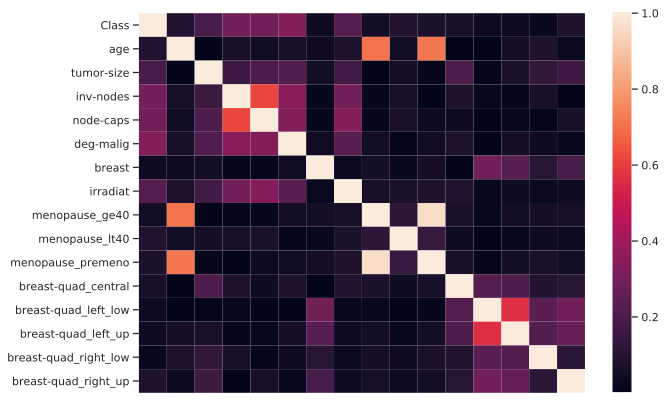

In [292]:
corril_abs = abs(df_breast_cancer.corr())

visual_data = corril_abs.iloc[:,:]
plt.figure(figsize = (10, 7))
sns.heatmap(visual_data, xticklabels = False)

#### Вывод:

1. Видим, что возраст довольно сильно коррелирует с менопаузой, что не противоречит логике.

2. Так же менопауза. !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!

3. Видим, что признаков, которые бы линейно коррелировали с предсказываемым классом нет. 

---

### 2. kBest

In [87]:
SkB = SelectKBest(chi2, k=5).fit(X_train, y_train)
zip(X.columns, SkB.get_support())

[('age', False),
 ('tumor-size', True),
 ('inv-nodes', True),
 ('node-caps', True),
 ('deg-malig', True),
 ('breast', False),
 ('irradiat', True),
 ('menopause_ge40', False),
 ('menopause_lt40', False),
 ('menopause_premeno', False),
 ('breast-quad_central', False),
 ('breast-quad_left_low', False),
 ('breast-quad_left_up', False),
 ('breast-quad_right_low', False),
 ('breast-quad_right_up', False)]

In [88]:
SkB = SelectKBest(chi2, k=5).fit(X_norm_train, y_train)
zip(X.columns, SkB.get_support())

[('age', False),
 ('tumor-size', False),
 ('inv-nodes', True),
 ('node-caps', True),
 ('deg-malig', True),
 ('breast', False),
 ('irradiat', True),
 ('menopause_ge40', False),
 ('menopause_lt40', False),
 ('menopause_premeno', False),
 ('breast-quad_central', False),
 ('breast-quad_left_low', False),
 ('breast-quad_left_up', False),
 ('breast-quad_right_low', False),
 ('breast-quad_right_up', True)]

Запустим алгоритм на 7 случайных подвыборках. Выберем 5 признаков с наибольшими весами, пометим их **True**, остальные **False**.

  Для **неотнормированной** выборки:
 
 ('age', False, False, False, False, True, False, False),  
 ('tumor-size', **True**, **True**, **True**, **True**, **True**, **True**, **True**),    
 ('inv-nodes', **True**, **True**, **True**, **True**, **True**, **True**, **True**),    
 ('node-caps', **True**, **True**, **True**, **True**, **True**, **True**, **True**),    
 ('deg-malig', **True**, **True**, **True**, **True**, False, **True**, **True**),    
 ('breast', False, False, False, False, False, False, False),  
 ('irradiat', **True**, **True**, **True**, **True**, **True**, **True**, **True**),    
 ('menopause_ge40', False, False, False, False, False, False, False),  
 ('menopause_lt40', False, False, False, False, False, False, False),  
 ('menopause_premeno', False, False, False, False, False, False, False),  
 ('breast-quad_central', False, False, False, False, False, False, False),  
 ('breast-quad_left_low', False, False, False, False, False, False, False),  
 ('breast-quad_left_up', False, False, False, False, False, False, False),  
 ('breast-quad_right_low', False, False, False, False, False, False, False),  
 ('breast-quad_right_up', False, False, False, False, False, False, False)
 
 Для **отнормированной** выборки:
 
 ('age', False, False, False, False, False, False, False),  
 ('tumor-size', False, False, False, False, False, False, False),  
 ('inv-nodes', **True**, **True**, **True**, **True**, **True**, **True**, **True**),  
 ('node-caps', **True**, **True**, **True**, **True**, **True**, **True**, **True**),  
 ('deg-malig', **True**, **True**, **True**, **True**, False, **True**, **True**),  
 ('breast', False, False, False, False, False, False, False),  
 ('irradiat', **True**, **True**, **True**, **True**, **True**, **True**, **True**),  
 ('menopause_ge40', False, False, False, False, False, False, False),  
 ('menopause_lt40', **True**, False, **True**, False, False, **True**, **True**),  
 ('menopause_premeno', False, False, False, False, False, False, False),  
 ('breast-quad_central', False, False, False, False, **True**, False, False),  
 ('breast-quad_left_low', False, False, False, False, False, False, False),  
 ('breast-quad_left_up', False, False, False, False, False, False, False),  
 ('breast-quad_right_low', False, False, False, False, False, False, False),  
 ('breast-quad_right_up', False, **True**, False, **True**, **True**, False, False)

#### Вывод:

I. Алгоритм **kBest** отобрал признаки в **неотнормированной выборке** (написаны в порядке уверенности в них алгоритма):

1. inv-nodes
2. tumor-size
3. node-caps
4. irradiat
5. deg-malig

II. Алгоритм **kBest** отобрал признаки в **отнормированной выборке**:

Выбраны почти всегда:

1. node-caps
2. irradiat
3. inv-nodes
4. deg-malig

Выбраны в половине случаев:

5. menopause_lt40

III. Видим, что признаки в одоих случая, за исключением одного, совпадают, однако сам алгоритм уверен в них по-разному.

---

### 3. RandomForestClassifare и feature_importances_ 

#### 3.1. Обучим случайный лес на отнормированных данных. Будем балансировать нашу выборку весами:

In [931]:
RFC_norm = RandomForestClassifier(max_depth=4, n_estimators=10000,class_weight='balanced')
RFC_norm.fit(X_norm_train,y_train)

RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='gini', max_depth=4, max_features='auto',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators=10000, n_jobs=None, oob_score=False,
            random_state=None, verbose=0, warm_start=False)

#### 3.2. Посмотрим на веса перед признаками:

In [932]:
zip(X.columns, np.around(RFC_norm.feature_importances_, decimals=5))

[('age', 0.06932),
 ('tumor-size', 0.19332),
 ('inv-nodes', 0.15119),
 ('node-caps', 0.11823),
 ('deg-malig', 0.16411),
 ('breast', 0.0405),
 ('irradiat', 0.04505),
 ('menopause_ge40', 0.02801),
 ('menopause_lt40', 0.0097),
 ('menopause_premeno', 0.04064),
 ('breast-quad_central', 0.01703),
 ('breast-quad_left_low', 0.01765),
 ('breast-quad_left_up', 0.03671),
 ('breast-quad_right_low', 0.03846),
 ('breast-quad_right_up', 0.03007)]

Запустим алгоритм на 7 случайных подвыборках. Выберем 5 признаков с наибольшими весами, пометим их **True**, остальные **False**.

('age',                    False, **True**, **True**, **True**, **True**, **True**, **True**),  
 ('tumor-size',            **True**, **True**, **True**, **True**, **True**, **True**, **True**),  
 ('inv-nodes',             **True**, **True**, **True**, **True**, **True**, **True**, **True**),  
 ('node-caps',             **True**, False, False, **True**, False, False, False),  
 ('deg-malig',             **True**, **True**, **True**, **True**, False, **True**, **True**),  
 ('breast',                False, False, **True**, **True**, False, False, False),  
 ('irradiat',              **True**, False, False, False, False, False, False),  
 ('menopause_ge40',        False, False, False, False, False, False, **True**),  
 ('menopause_lt40',        False, False, False, False, False, False, False),  
 ('menopause_premeno',     False, False, False, False, False, False, False),  
 ('breast-quad_central',   False, False, False, False, **True**, False, False),  
 ('breast-quad_left_low',  False, False, False, False, False, **True**, False),  
 ('breast-quad_left_up',   False, False, False, False, False, False, False),  
 ('breast-quad_right_low', False, **True**, False, False, False, False, False),  
 ('breast-quad_right_up',  False, False, False, False, **True**, False, False)

#### Вывод:

Алгоритм RandomForestClassifare поставил наибольшие веса перед признаками:

1. age
2. tumor-size
3. inv-nodes
4. deg-malig

Выбор остальных признаков неустойчив.

---

### 4. SGDClassifier и Lasso-регуляризация:

In [216]:
clf = linear_model.SGDClassifier(max_iter=10000, alpha=0.01, tol=1e-6, penalty='l1', random_state=1)
clf.fit(X_norm_train, y_train)

SGDClassifier(alpha=0.01, average=False, class_weight=None,
       early_stopping=False, epsilon=0.1, eta0=0.0, fit_intercept=True,
       l1_ratio=0.15, learning_rate='optimal', loss='hinge',
       max_iter=10000, n_iter=None, n_iter_no_change=5, n_jobs=None,
       penalty='l1', power_t=0.5, random_state=1, shuffle=True, tol=1e-06,
       validation_fraction=0.1, verbose=0, warm_start=False)

In [217]:
zip(X.columns, np.around(clf.coef_[0], decimals=5))

[('age', 0.0),
 ('tumor-size', 0.0),
 ('inv-nodes', 0.0),
 ('node-caps', 1.97449),
 ('deg-malig', 0.10002),
 ('breast', 0.0),
 ('irradiat', 0.01052),
 ('menopause_ge40', 0.0),
 ('menopause_lt40', 0.0),
 ('menopause_premeno', 0.01095),
 ('breast-quad_central', 0.0),
 ('breast-quad_left_low', 0.0),
 ('breast-quad_left_up', -0.00515),
 ('breast-quad_right_low', 0.0),
 ('breast-quad_right_up', 0.00812)]

Запустим алгоритм на 7 случайных подвыборках. Выберем признаки с наибольшими весами, пометим их True, остальные False.

('age',                   False,     False,       False,         False,        False,        False,      False),  
 ('tumor-size',            False,     **True**, **True**,   **True**,  False,        **True**,  **True**),  
 ('inv-nodes',             **True**, **True**, **True**,   False,        **True**,   False,        **True**),  
 ('node-caps',             False,       **True**, False,     **True**,  False,       False,        **True**),  
 ('deg-malig',             **True**, **True**, **True**,   **True**,  **True**,   **True**,   **True**),  
 ('breast',               False,    False,     False,         False,        False,       False,      False),  
 ('irradiat',              False,     **True**, **True**,   **True**,   **True**,   False,      **True**),  
 ('menopause_ge40',        **True**, False,       False,         False,        False,        **True**,  False),  
 ('menopause_lt40',      **True**, False,       **True**, **True**, **True**, **True**, False),  
 ('menopause_premeno',     **True**, False,     False,         False,      **True**,    **True**,  False),  
 ('breast-quad_central',   False,       False,       False,         False,        False,       False,      False),  
 ('breast-quad_left_low',  False,       False,     False,         False,        False,        False,        False),  
 ('breast-quad_left_up',   False,      False,     False,      False,      False,        False,        False),  
 ('breast-quad_right_low', False,       False,       False,        False,     False,       False,        False),  
 ('breast-quad_right_up',  False,     **True**, False,         False,      False,       False,        False)  

#### Вывод:

Подобрав коэфициент перед регуляризацией, находим 5 значимых признаков:

1. tumor-size
2. inv-nodes
3. deg-malig
4. irradiat
5. menopause_lt40

---

### 5. Рекурсивное исключение признаков

In [278]:
LR = linear_model.SGDClassifier(max_iter=10000,tol=1e-6)

RFE_ = RFE(LR, 5)

RFE_fitted = RFE_.fit(X_norm_train, y_train)

print("Selected Features: %s") % RFE_fitted.support_,'\n'

Selected Features: [False  True  True False  True False False False  True  True False False
 False False False] 



In [221]:
zip(X.columns,RFE_fitted.support_)

[('age', False),
 ('tumor-size', True),
 ('inv-nodes', True),
 ('node-caps', False),
 ('deg-malig', True),
 ('breast', False),
 ('irradiat', False),
 ('menopause_ge40', False),
 ('menopause_lt40', True),
 ('menopause_premeno', True),
 ('breast-quad_central', False),
 ('breast-quad_left_low', False),
 ('breast-quad_left_up', False),
 ('breast-quad_right_low', False),
 ('breast-quad_right_up', False)]

Запустим алгоритм на 7 случайных подвыборках. Выберем 5 признаков с наибольшими весами, пометим их **True**, остальные **False**.

('age', False, False, False, **True**, False, True, False),  
 ('tumor-size', **True**, **True**, **True**, False, False, **True**, **True**),  
 ('inv-nodes', **True**, **True**, **True**, False, **True**, False, **True**),  
 ('node-caps', False, **True**, False, False, False, **True**, False),  
 ('deg-malig', **True**, **True**, **True**, **True**, **True**, **True**, **True**),  
 ('breast', False, False, False, False, False, False, False),  
 ('irradiat', False, False, False, **True**, False, False, False),  
 ('menopause_ge40', False, False, False, False, **True**, False, False),  
 ('menopause_lt40', **True**, **True**, **True**, **True**, **True**, **True**, **True**),  
 ('menopause_premeno', False, False, False, **True**, **True**, False, **True**),  
 ('breast-quad_central', False, False, False, False, False, False, False),  
 ('breast-quad_left_low', False, False, False, False, False, False, False),  
 ('breast-quad_left_up', False, False, **True**, False, False, False, False),  
 ('breast-quad_right_low', False, False, False, False, False, False, False),  
 ('breast-quad_right_up', **True**, False, False, False, False, False, False)

#### Вывод:

Алгоритм рекурсивного удаления оставил следующие признаки:
    
1. tumor-size
2. inv-nodes
3. deg-malig
4. menopause_lt40

---

Заметим, что есть признаки, которые не были выбраны ни одним алгоритмом отбора. 

Из этого можно сделать вывод, что эти признаки являются шумовыми,а значит при использовании алгоритмов понижения размерности, мы не будем использовать их.

### 6. PCA

In [243]:
X_PCA_2 = pd.DataFrame(PCA(n_components=2).fit_transform(X_norm_train))

X_PCA_3_train = pd.DataFrame(PCA(n_components=3).fit_transform(X_norm_train))
X_PCA_4_train = pd.DataFrame(PCA(n_components=4).fit_transform(X_norm_train))
X_PCA_5_train = pd.DataFrame(PCA(n_components=5).fit_transform(X_norm_train))
X_PCA_3_test = pd.DataFrame(PCA(n_components=3).fit_transform(X_norm_test))
X_PCA_4_test = pd.DataFrame(PCA(n_components=4).fit_transform(X_norm_test))
X_PCA_5_test = pd.DataFrame(PCA(n_components=5).fit_transform(X_norm_test))

X_PCA_3 = pd.DataFrame(PCA(n_components=3).fit_transform(X_norm))
X_PCA_4 = pd.DataFrame(PCA(n_components=4).fit_transform(X_norm))
X_PCA_5 = pd.DataFrame(PCA(n_components=5).fit_transform(X_norm))

In [244]:
X_PCA_2_selectively_train = pd.DataFrame(PCA(n_components=2).fit_transform(X_norm_train[['node-caps','irradiat','inv-nodes','deg-malig','menopause_lt40','age','tumor-size']]))
X_PCA_2_selectively_test = pd.DataFrame(PCA(n_components=2).fit_transform(X_norm_test[['node-caps','irradiat','inv-nodes','deg-malig','menopause_lt40','age','tumor-size']]))
X_PCA_2_selectively = pd.DataFrame(PCA(n_components=2).fit_transform(X_norm[['node-caps','irradiat','inv-nodes','deg-malig','menopause_lt40','age','tumor-size']]))

#### Вывод:

##### 1. Работа PCA на всей выборке:

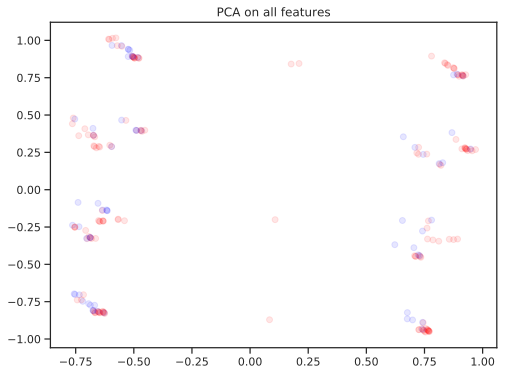

In [196]:
fig, ax = plt.subplots(figsize=(8, 6), dpi=120)

ax.scatter(X_PCA_2[0][y_train.reset_index(drop=True)==0], X_PCA_2[1][y_train.reset_index(drop=True)==0], c = 'red', alpha=0.1)
ax.scatter(X_PCA_2[0][y_train.reset_index(drop=True)==1], X_PCA_2[1][y_train.reset_index(drop=True)==1], c = 'blue', alpha=0.1) 

plt.title('PCA on all features')
plt.show()

##### 2. Работа PCA на 4 выбранных ранее признаках:

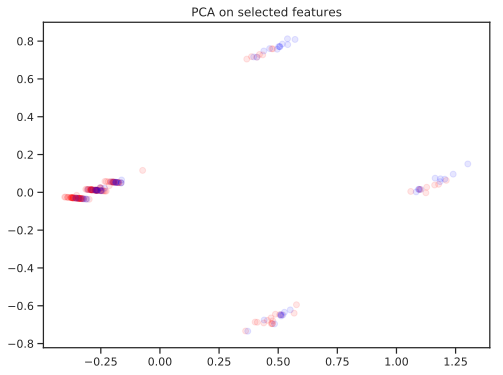

In [298]:
fig, ax = plt.subplots(figsize=(8, 6), dpi=120)

ax.scatter(X_PCA_2_selectively_train[0][y_train.reset_index(drop=True)==0], X_PCA_2_selectively_train[1][y_train.reset_index(drop=True)==0], c = 'red', alpha=0.1)
ax.scatter(X_PCA_2_selectively_train[0][y_train.reset_index(drop=True)==1], X_PCA_2_selectively_train[1][y_train.reset_index(drop=True)==1], c = 'blue', alpha=0.1) 

plt.title('PCA on selected features')
plt.show()

---

### 7. t-SNE

In [245]:
X_TSNE_2_train = pd.DataFrame(TSNE(n_components=2).fit_transform(X_norm_train))
X_TSNE_3_train = pd.DataFrame(TSNE(n_components=3).fit_transform(X_norm_train))
X_TSNE_2_test = pd.DataFrame(TSNE(n_components=2).fit_transform(X_norm_test))
X_TSNE_3_test = pd.DataFrame(TSNE(n_components=3).fit_transform(X_norm_test))

X_TSNE_2_selectively = pd.DataFrame(TSNE(n_components=2).fit_transform(X_norm[['node-caps','irradiat','inv-nodes','deg-malig','menopause_lt40','age','tumor-size']]))
X_TSNE_3 = pd.DataFrame(TSNE(n_components=3).fit_transform(X_norm))

In [246]:
X_TSNE_2_selectively_train = pd.DataFrame(TSNE(n_components=2).fit_transform(X_norm_train[['node-caps','irradiat','inv-nodes','deg-malig','menopause_lt40','age','tumor-size']]))
X_TSNE_2_selectively_test = pd.DataFrame(TSNE(n_components=2).fit_transform(X_norm_test[['node-caps','irradiat','inv-nodes','deg-malig','menopause_lt40','age','tumor-size']]))

#### Вывод:

##### 1. Работа t-SNE на всей выборке:

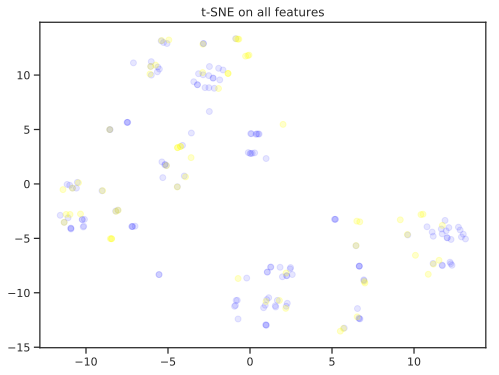

In [233]:
fig, ax = plt.subplots(figsize=(8, 6), dpi=120)

ax.scatter(X_TSNE_2_train[0][y_train.reset_index(drop=True)==0], X_TSNE_2_train[1][y_train.reset_index(drop=True)==0], c = 'blue', alpha=0.1)
ax.scatter(X_TSNE_2_train[0][y_train.reset_index(drop=True)==1], X_TSNE_2_train[1][y_train.reset_index(drop=True)==1], c = 'yellow', alpha=0.2) 

plt.title('t-SNE on all features')
plt.show()

##### 2. Работа t-SNE на 4 выбранных ранее признаках:

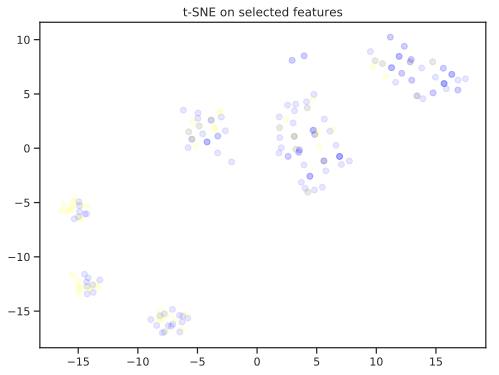

In [296]:
fig, ax = plt.subplots(figsize=(8, 6), dpi=120)

ax.scatter(X_TSNE_2_selectively_train[0][y_train.reset_index(drop=True)==0], X_TSNE_2_selectively_train[1][y_train.reset_index(drop=True)==0], c = 'blue', alpha=0.1)
ax.scatter(X_TSNE_2_selectively_train[0][y_train.reset_index(drop=True)==1], X_TSNE_2_selectively_train[1][y_train.reset_index(drop=True)==1], c = 'yellow', alpha=0.1) 

plt.title('t-SNE on selected features')
plt.show()

Видно, что размерности 2 не хватает для разделения объектов.

---

### 8. UMAP

In [118]:
embedding = pd.DataFrame(UMAP.UMAP(n_neighbors=60).fit_transform(X_norm_train))

In [119]:
embedding_selectively = pd.DataFrame(UMAP.UMAP(n_neighbors=20).fit_transform(X_norm_train[['node-caps','irradiat','inv-nodes','deg-malig','menopause_lt40','age','tumor-size']]))

#### Вывод:

##### 1. Работа UMAP на всей выборке:

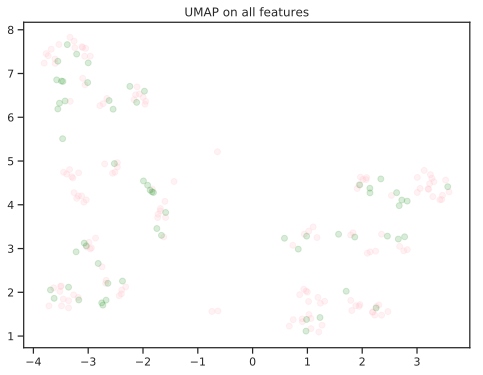

In [218]:
fig, ax = plt.subplots(figsize=(8, 6), dpi=120)

ax.scatter(embedding[0][y_train.reset_index(drop=True)==0], embedding[1][y_train.reset_index(drop=True)==0], c = 'pink', alpha=0.2)
ax.scatter(embedding[0][y_train.reset_index(drop=True)==1], embedding[1][y_train.reset_index(drop=True)==1], c = 'green', alpha=0.15) 

plt.title('UMAP on all features')
plt.show()

##### 2. Работа UMAP на 4 выбранных ранее признаках:

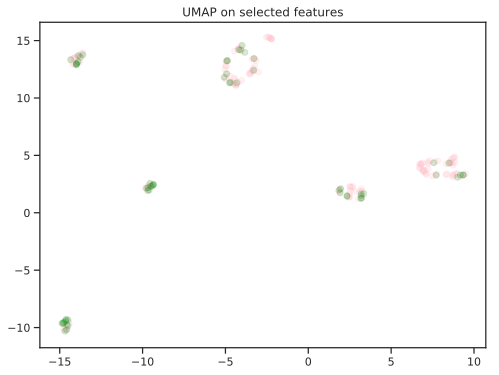

In [300]:
fig, ax = plt.subplots(figsize=(8, 6), dpi=120)

ax.scatter(embedding_selectively[0][y_train.reset_index(drop=True)==0], embedding_selectively[1][y_train.reset_index(drop=True)==0], c = 'pink', alpha=0.2)
ax.scatter(embedding_selectively[0][y_train.reset_index(drop=True)==1], embedding_selectively[1][y_train.reset_index(drop=True)==1], c = 'green', alpha=0.15) 

plt.title('UMAP on selected features')
plt.show()

К сожалению алгоритм не дал желаемого результата.

---

## Итог отбора признаков:

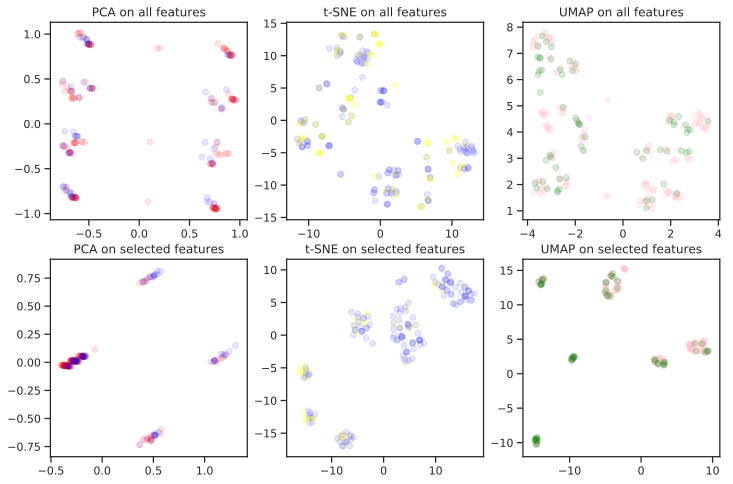

In [301]:
fig, axes = plt.subplots(2,3,figsize=(12, 8))

axes[0,0].scatter(X_PCA_2[0][y_train.reset_index(drop=True)==0], X_PCA_2[1][y_train.reset_index(drop=True)==0], c = 'red', alpha=0.1)
axes[0,0].scatter(X_PCA_2[0][y_train.reset_index(drop=True)==1], X_PCA_2[1][y_train.reset_index(drop=True)==1], c = 'blue', alpha=0.1) 
axes[0,0].set_title('PCA on all features')


axes[1,0].scatter(X_PCA_2_selectively_train[0][y_train.reset_index(drop=True)==0], X_PCA_2_selectively_train[1][y_train.reset_index(drop=True)==0], c = 'red', alpha=0.1)
axes[1,0].scatter(X_PCA_2_selectively_train[0][y_train.reset_index(drop=True)==1], X_PCA_2_selectively_train[1][y_train.reset_index(drop=True)==1], c = 'blue', alpha=0.1) 
axes[1,0].set_title('PCA on selected features')


axes[0,1].scatter(X_TSNE_2_train[0][y_train.reset_index(drop=True)==0], X_TSNE_2_train[1][y_train.reset_index(drop=True)==0], c = 'blue', alpha=0.1)
axes[0,1].scatter(X_TSNE_2_train[0][y_train.reset_index(drop=True)==1], X_TSNE_2_train[1][y_train.reset_index(drop=True)==1], c = 'yellow', alpha=0.2) 
axes[0,1].set_title('t-SNE on all features')


axes[1,1].scatter(X_TSNE_2_selectively_train[0][y_train.reset_index(drop=True)==0], X_TSNE_2_selectively_train[1][y_train.reset_index(drop=True)==0], c = 'blue', alpha=0.1)
axes[1,1].scatter(X_TSNE_2_selectively_train[0][y_train.reset_index(drop=True)==1], X_TSNE_2_selectively_train[1][y_train.reset_index(drop=True)==1], c = 'yellow', alpha=0.1) 
axes[1,1].set_title('t-SNE on selected features')


axes[0,2].scatter(embedding[0][y_train.reset_index(drop=True)==0], embedding[1][y_train.reset_index(drop=True)==0], c = 'pink', alpha=0.2)
axes[0,2].scatter(embedding[0][y_train.reset_index(drop=True)==1], embedding[1][y_train.reset_index(drop=True)==1], c = 'green', alpha=0.15) 
axes[0,2].set_title('UMAP on all features')


axes[1,2].scatter(embedding_selectively[0][y_train.reset_index(drop=True)==0], embedding_selectively[1][y_train.reset_index(drop=True)==0], c = 'pink', alpha=0.2)
axes[1,2].scatter(embedding_selectively[0][y_train.reset_index(drop=True)==1], embedding_selectively[1][y_train.reset_index(drop=True)==1], c = 'green', alpha=0.15) 
axes[1,2].set_title('UMAP on selected features')

plt.show()

<HTML>
<h2 style='padding: 10px;'><center>Таблица отобранных признаков</center></h2>
<table class='table table-striped' style='border:1px solid'>
    <thead> 
        <tr> 
            <th><center>kBest(на неотнормированной)</center></th> <th><center>kBest(на отнормированной)</center></th> <th><center>RandomForestClassifier</center></th> <th><center>SGDClassifier</center></th> <th><center>RFE</center></th>
        </tr> 
    </thead> 
    <tbody> 
        <tr> 
            <td style="background-color:#bae6c0" ><center>inv-nodes</center></td> <td style="background-color:LightCyan"><center>node-caps</center></td> <td style="background-color:PaleGoldenrod"><center>tumor-size</center></td> <td style="background-color:PaleGoldenrod"><center>tumor-size</center></td> <td style="background-color:PaleGoldenrod"><center>tumor-size</center></td> 
        </tr>
        <tr> 
            <td style="background-color:PaleGoldenrod"><center>tumor-size</center></td> <td style="background-color:Lavender"><center>irradiat</center></td> <td style="background-color:LightYellow"><center>deg-malig</center></td> <td style="background-color:LightYellow"><center>deg-malig</center></td> <td style="background-color:#bae6c0"><center>inv-nodes</center></td> 
        </tr>
        <tr>
            <td style="background-color:LightCyan"><center>node-caps</center></td> <td style="background-color:#bae6c0"><center>inv-nodes</center></td> <td style="background-color:#bae6c0"><center>inv-nodes</center></td> <td style="background-color:Lavender"><center>irradiat</center></td> <td style="background-color:LightYellow"><center>deg-malig</center></td> 
        </tr> 
        <tr>
            <td style="background-color:Lavender"><center>irradiat</center></td> <td style="background-color:LightYellow"><center>deg-malig</center></td> <td style="background-color:BurlyWood"><center>age</center></td> <td style="background-color:#bae6c0"><center>inv-nodes</center></td> <td style="background-color:RosyBrown"><center>menopause_lt40</center></td> 
        </tr> 
        <tr>
            <td style="background-color:LightYellow"><center>deg-malig</center></td> <td style="background-color:RosyBrown"><center>menopause_lt40</center></td> <td style="background-color:Silver"><center >--</center></td> <td style="background-color:RosyBrown"><center>menopause_lt40</center></td> <td style="background-color:Silver"><center>--</center></td> 
        </tr> 
    </tbody> 
    
</table>
<HTML>

Из отобранных признаков составим 8 подвыборок:

In [277]:
X_train_1 = X_norm_train[['inv-nodes','tumor-size','node-caps','irradiat','deg-malig']]
X_test_1 = X_norm_test[['inv-nodes','tumor-size','node-caps','irradiat','deg-malig']]
X_1 = X_norm[['inv-nodes','tumor-size','node-caps','irradiat','deg-malig']]

X_train_2 = X_norm_train[['inv-nodes','node-caps','irradiat','deg-malig','menopause_lt40']]
X_test_2 = X_norm_test[['inv-nodes','node-caps','irradiat','deg-malig','menopause_lt40']]
X_2 = X_norm[['inv-nodes','node-caps','irradiat','deg-malig','menopause_lt40']]

X_train_3 = X_norm_train[['tumor-size','inv-nodes','deg-malig','age']]
X_test_3 = X_norm_test[['tumor-size','inv-nodes','deg-malig','age']]
X_3 = X_norm[['tumor-size','inv-nodes','deg-malig','age']]

X_train_4 = X_norm_train[['tumor-size','inv-nodes','irradiat','deg-malig','menopause_lt40']]
X_test_4 = X_norm_test[['tumor-size','inv-nodes','irradiat','deg-malig','menopause_lt40']]
X_4 = X_norm[['tumor-size','inv-nodes','irradiat','deg-malig','menopause_lt40']]

X_train_5 = X_norm_train[['inv-nodes','tumor-size','deg-malig']]
X_test_5 = X_norm_test[['inv-nodes','tumor-size','deg-malig']]
X_5 = X_norm[['inv-nodes','tumor-size','deg-malig']]

X_train_6 = X_norm_train[['inv-nodes','tumor-size','menopause_lt40','deg-malig']]
X_test_6 = X_norm_test[['inv-nodes','tumor-size','menopause_lt40','deg-malig']]
X_6 = X_norm[['inv-nodes','tumor-size','menopause_lt40','deg-malig']]

X_train_7 = X_norm_train[['inv-nodes','tumor-size','age','deg-malig','irradiat']]
X_test_7 = X_norm_test[['inv-nodes','tumor-size','age','deg-malig','irradiat']]
X_7 = X_norm[['inv-nodes','tumor-size','age','deg-malig','irradiat']]

X_train_8 = X_norm_train[['inv-nodes','node-caps','age','deg-malig','irradiat']]
X_test_8 = X_norm_test[['inv-nodes','node-caps','age','deg-malig','irradiat']]
X_8 = X_norm[['inv-nodes','node-caps','age','deg-malig','irradiat']]

y_for_reduced_dimension_train = y_train.reset_index(drop=True)
y_for_reduced_dimension_test = y_test.reset_index(drop=True)

## Классификация на Base-line алгоритмах

### 1. Наивный байесовский классификатор

#### 1.1 Импортируем библиотеку, содержащую алгоритм:

In [61]:
from sklearn.naive_bayes import MultinomialNB

#### 1.2 Опробуем и настроим алгоритм на нормализованных данных, без отбора признаков:

In [624]:
MNB = MultinomialNB(fit_prior=False)

MNB.fit(X_norm_train,y_train)

control_error(X_norm_train, y_train, X_norm_test, y_test, MNB, all_data=X_norm, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.643
                  ROC-AUC on the test: 0.669

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.707
          Estimation of ROC-AUC by cross validation 0.667

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.64
               Accuracy on 1 class on test: 0.65

 <------------------------------------------------------------> 



#### 1.3 Настроим алгоритм на подвыборках их данных:

##### 1.3.1 На признаках ['inv-nodes','tumor-size','node-caps','irradiat','deg-malig']:

In [363]:
MNB = MultinomialNB(fit_prior=False)

MNB.fit(X_train_1,y_train)

control_error(X_train_1, y_train, X_test_1, y_test, MNB, all_data=X_1, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.686
                  ROC-AUC on the test: 0.669

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.7
          Estimation of ROC-AUC by cross validation 0.598

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.76
               Accuracy on 1 class on test: 0.5

 <------------------------------------------------------------> 



##### 1.3.2 На признаках ['inv-nodes','node-caps','irradiat','deg-malig','menopause_lt40']:

In [364]:
MNB = MultinomialNB(fit_prior=False)

MNB.fit(X_train_2,y_train)

control_error(X_train_2, y_train, X_test_2, y_test, MNB, all_data=X_2, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.657
                  ROC-AUC on the test: 0.662

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.7
          Estimation of ROC-AUC by cross validation 0.627

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.7
               Accuracy on 1 class on test: 0.55

 <------------------------------------------------------------> 



##### 1.3.3 На признаках ['tumor-size','inv-nodes','deg-malig','age']:

In [365]:
MNB = MultinomialNB(fit_prior=False)

MNB.fit(X_train_3,y_train)

control_error(X_train_3, y_train, X_test_3, y_test, MNB, all_data=X_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.739

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.729
          Estimation of ROC-AUC by cross validation 0.708

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.82
               Accuracy on 1 class on test: 0.55

 <------------------------------------------------------------> 



##### 1.3.4 На признаках ['tumor-size','inv-nodes','irradiat','deg-malig','menopause_lt40']:

In [366]:
MNB = MultinomialNB(fit_prior=False)

MNB.fit(X_train_4,y_train)

control_error(X_train_4, y_train, X_test_4, y_test, MNB, all_data=X_4, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.712

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.707
          Estimation of ROC-AUC by cross validation 0.588

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.8
               Accuracy on 1 class on test: 0.6

 <------------------------------------------------------------> 



##### 1.3.5 На признаках ['inv-nodes','tumor-size','deg-malig']:

In [367]:
MNB = MultinomialNB(fit_prior=False)

MNB.fit(X_train_5,y_train)

control_error(X_train_5, y_train, X_test_5, y_test, MNB, all_data=X_5, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.771
                  ROC-AUC on the test: 0.645

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.73
          Estimation of ROC-AUC by cross validation 0.566

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.86
               Accuracy on 1 class on test: 0.55

 <------------------------------------------------------------> 



##### 1.3.6 На признаках ['inv-nodes','tumor-size','menopause_lt40','deg-malig']:

In [368]:
MNB = MultinomialNB(fit_prior=False)

MNB.fit(X_train_6,y_train)

control_error(X_train_6, y_train, X_test_6, y_test, MNB, all_data=X_6, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.643
                  ROC-AUC on the test: 0.685

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.587
          Estimation of ROC-AUC by cross validation 0.611

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.68
               Accuracy on 1 class on test: 0.55

 <------------------------------------------------------------> 



##### 1.3.7 На признаках ['inv-nodes','tumor-size','age','deg-malig','irradiat']:

In [369]:
MNB = MultinomialNB(fit_prior=False)

MNB.fit(X_train_7,y_train)

control_error(X_train_7, y_train, X_test_7, y_test, MNB, all_data=X_7, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.757
                  ROC-AUC on the test: 0.784

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.704
          Estimation of ROC-AUC by cross validation 0.685

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.8
               Accuracy on 1 class on test: 0.65

 <------------------------------------------------------------> 



##### 1.3.8 На признаках ['inv-nodes','node-caps','age','deg-malig','irradiat']:

In [370]:
MNB = MultinomialNB(fit_prior=False)

MNB.fit(X_train_8,y_train)

control_error(X_train_8, y_train, X_test_8, y_test, MNB, all_data=X_8, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.686
                  ROC-AUC on the test: 0.725

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.708
          Estimation of ROC-AUC by cross validation 0.684

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.72
               Accuracy on 1 class on test: 0.6

 <------------------------------------------------------------> 



---

### 2. k-nn

#### 2.1 Импортируем библиотеку, содержащую алгоритм:

In [373]:
from sklearn.neighbors import KNeighborsClassifier

#### 2.2 Опробуем и настроим алгоритм на нормализованных данных, без отбора признаков:

In [725]:
KNC = KNeighborsClassifier(n_neighbors=5)

KNC.fit(X_norm_train,y_train)

control_error(X_norm_train, y_train, X_norm_test, y_test, KNC, all_data=X_norm, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.681

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.762
          Estimation of ROC-AUC by cross validation 0.666

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.9
               Accuracy on 1 class on test: 0.35

 <------------------------------------------------------------> 



#### 2.3 Настроим алгоритм на подвыборках их данных:

##### 2.3.1 На признаках ['inv-nodes','tumor-size','node-caps','irradiat','deg-malig']:

In [746]:
KNC = KNeighborsClassifier(n_neighbors=5,algorithm = 'kd_tree')

KNC.fit(X_train_1,y_train)

control_error(X_train_1, y_train, X_test_1, y_test, KNC, all_data=X_1, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.8
                  ROC-AUC on the test: 0.766

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.725
          Estimation of ROC-AUC by cross validation 0.677

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.88
               Accuracy on 1 class on test: 0.6

 <------------------------------------------------------------> 



##### 2.3.2 На признаках ['inv-nodes','node-caps','irradiat','deg-malig','menopause_lt40']:

In [733]:
KNC = KNeighborsClassifier(n_neighbors=3,algorithm = 'kd_tree')

KNC.fit(X_train_2,y_train)

control_error(X_train_2, y_train, X_test_2, y_test, KNC, all_data=X_2, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.814
                  ROC-AUC on the test: 0.752

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.743
          Estimation of ROC-AUC by cross validation 0.669

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.9
               Accuracy on 1 class on test: 0.6

 <------------------------------------------------------------> 



##### 2.3.3 На признаках ['tumor-size','inv-nodes','deg-malig','age']:

In [742]:
KNC = KNeighborsClassifier(n_neighbors=5,algorithm = 'kd_tree')

KNC.fit(X_train_3,y_train)

control_error(X_train_3, y_train, X_test_3, y_test, KNC, all_data=X_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.786
                  ROC-AUC on the test: 0.752

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.718
          Estimation of ROC-AUC by cross validation 0.655

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.45

 <------------------------------------------------------------> 



##### 2.3.4 На признаках ['tumor-size','inv-nodes','irradiat','deg-malig','menopause_lt40']:

In [750]:
KNC = KNeighborsClassifier(n_neighbors=3,algorithm = 'kd_tree')

KNC.fit(X_train_4,y_train)

control_error(X_train_4, y_train, X_test_4, y_test, KNC, all_data=X_4, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.771
                  ROC-AUC on the test: 0.735

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.751
          Estimation of ROC-AUC by cross validation 0.664

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.86
               Accuracy on 1 class on test: 0.55

 <------------------------------------------------------------> 



##### 2.3.5 На признаках ['inv-nodes','tumor-size','deg-malig']:

In [758]:
KNC = KNeighborsClassifier(n_neighbors=3,algorithm = 'kd_tree')

KNC.fit(X_train_5,y_train)

control_error(X_train_5, y_train, X_test_5, y_test, KNC, all_data=X_5, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.671
                  ROC-AUC on the test: 0.617

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.737
          Estimation of ROC-AUC by cross validation 0.635

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.76
               Accuracy on 1 class on test: 0.45

 <------------------------------------------------------------> 



##### 2.3.6 На признаках ['inv-nodes','tumor-size','menopause_lt40','deg-malig']:

In [764]:
KNC = KNeighborsClassifier(n_neighbors=5,algorithm='kd_tree')

KNC.fit(X_train_6,y_train)

control_error(X_train_6, y_train, X_test_6, y_test, KNC, all_data=X_6, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.705

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.736
          Estimation of ROC-AUC by cross validation 0.666

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.3

 <------------------------------------------------------------> 



##### 2.3.7 На признаках ['inv-nodes','tumor-size','age','deg-malig','irradiat']:

In [767]:
KNC = KNeighborsClassifier(n_neighbors=5,algorithm='kd_tree')

KNC.fit(X_train_7,y_train)

control_error(X_train_7, y_train, X_test_7, y_test, KNC, all_data=X_7, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.814
                  ROC-AUC on the test: 0.743

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.733
          Estimation of ROC-AUC by cross validation 0.628

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.96
               Accuracy on 1 class on test: 0.45

 <------------------------------------------------------------> 



##### 2.3.8 На признаках ['inv-nodes','node-caps','age','deg-malig','irradiat']:

In [771]:
KNC = KNeighborsClassifier(n_neighbors=5,algorithm='kd_tree')

KNC.fit(X_train_8,y_train)

control_error(X_train_8, y_train, X_test_8, y_test, KNC, all_data=X_8, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.771
                  ROC-AUC on the test: 0.766

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.737
          Estimation of ROC-AUC by cross validation 0.712

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.4

 <------------------------------------------------------------> 



#### 2.4 Настроим алгоритм на данных, полученных методом понижения размерности:

##### 2.4.1 TSN-e до 2 признаков:

In [775]:
KNC = KNeighborsClassifier(n_neighbors=5,algorithm='kd_tree')

KNC.fit(X_TSNE_2_selectively_train,y_for_reduced_dimension_train)

control_error(X_TSNE_2_selectively_train, y_for_reduced_dimension_train , X_TSNE_2_selectively_test, y_for_reduced_dimension_test, KNC, all_data=X_TSNE_2_selectively, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.714
                  ROC-AUC on the test: 0.702

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.737
          Estimation of ROC-AUC by cross validation 0.671

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.78
               Accuracy on 1 class on test: 0.55

 <------------------------------------------------------------> 



##### 2.4.2 TSN-e до 3 признаков:

In [828]:
KNC = KNeighborsClassifier(n_neighbors=3,algorithm='kd_tree')

KNC.fit(X_TSNE_3_train,y_for_reduced_dimension_train)

control_error(X_TSNE_3_train, y_for_reduced_dimension_train , X_TSNE_3_test, y_for_reduced_dimension_test, KNC, all_data=X_TSNE_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.614
                  ROC-AUC on the test: 0.605

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.65
          Estimation of ROC-AUC by cross validation 0.609

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.72
               Accuracy on 1 class on test: 0.35

 <------------------------------------------------------------> 



##### 2.4.3 PCA до 2 признаков

In [849]:
KNC = KNeighborsClassifier(n_neighbors=5,algorithm='kd_tree')

KNC.fit(X_PCA_2_selectively_train,y_for_reduced_dimension_train)

control_error(X_PCA_2_selectively_train, y_for_reduced_dimension_train , X_PCA_2_selectively_test, y_for_reduced_dimension_test, KNC, all_data=X_PCA_2_selectively, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.7
                  ROC-AUC on the test: 0.724

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.737
          Estimation of ROC-AUC by cross validation 0.64

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.88
               Accuracy on 1 class on test: 0.25

 <------------------------------------------------------------> 



##### 2.4.4 PCA до 3 признаков:

In [818]:
KNC = KNeighborsClassifier(n_neighbors=5,algorithm='kd_tree')

KNC.fit(X_PCA_3_train,y_for_reduced_dimension_train)

control_error(X_PCA_3_train, y_for_reduced_dimension_train , X_PCA_3_test, y_for_reduced_dimension_test, KNC, all_data=X_PCA_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.657
                  ROC-AUC on the test: 0.583

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.719
          Estimation of ROC-AUC by cross validation 0.704

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.82
               Accuracy on 1 class on test: 0.25

 <------------------------------------------------------------> 



##### 2.4.5 PCA до 4 признаков:

In [815]:
KNC = KNeighborsClassifier(n_neighbors=5,algorithm='kd_tree')

KNC.fit(X_PCA_4_train,y_for_reduced_dimension_train)

control_error(X_PCA_4_train, y_for_reduced_dimension_train , X_PCA_4_test, y_for_reduced_dimension_test, KNC, all_data=X_PCA_4, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.7
                  ROC-AUC on the test: 0.594

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.761
          Estimation of ROC-AUC by cross validation 0.689

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.82
               Accuracy on 1 class on test: 0.4

 <------------------------------------------------------------> 



##### 2.4.6 PCA на до 5 признаков:

In [841]:
KNC = KNeighborsClassifier(n_neighbors=5,algorithm='kd_tree')

KNC.fit(X_PCA_5_train,y_for_reduced_dimension_train)

control_error(X_PCA_5_train, y_for_reduced_dimension_train , X_PCA_5_test, y_for_reduced_dimension_test, KNC, all_data=X_PCA_5, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.7
                  ROC-AUC on the test: 0.681

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.722
          Estimation of ROC-AUC by cross validation 0.7

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.9
               Accuracy on 1 class on test: 0.2

 <------------------------------------------------------------> 



---

### 3. RandomForestClassifier

#### 3.1 Импортируем библиотеку, содержащую алгоритм:

In [933]:
from sklearn.ensemble import RandomForestClassifier

#### 3.2 Опробуем и настроим алгоритм на нормализованных данных, без отобранных признаков:

In [703]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')
RFC.fit(X_norm_train,y_train)

control_error(X_norm_train, y_train, X_norm_test, y_test, RFC, all_data=X_norm, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.788

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.683
          Estimation of ROC-AUC by cross validation 0.684

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.78
               Accuracy on 1 class on test: 0.65

 <------------------------------------------------------------> 



#### 3.3 Настроим алгоритм на подвыборках их данных:

##### 3.3.1 На признаках ['inv-nodes','tumor-size','node-caps','irradiat','deg-malig']:

In [706]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')
RFC.fit(X_train_1,y_train)

control_error(X_train_1, y_train, X_test_1, y_test, RFC, all_data=X_1, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.809

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.714
          Estimation of ROC-AUC by cross validation 0.603

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.74
               Accuracy on 1 class on test: 0.75

 <------------------------------------------------------------> 



##### 3.3.2 На признаках ['inv-nodes','node-caps','irradiat','deg-malig','menopause_lt40']:

In [707]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')
RFC.fit(X_train_2,y_train)

control_error(X_train_2, y_train, X_test_2, y_test, RFC, all_data=X_2, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.815

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.7
          Estimation of ROC-AUC by cross validation 0.625

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.74
               Accuracy on 1 class on test: 0.75

 <------------------------------------------------------------> 



##### 3.3.3 На признаках ['tumor-size','inv-nodes','deg-malig','age']:

In [1310]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')
RFC.fit(X_train_3,y_train)

control_error(X_train_3, y_train, X_test_3, y_test, RFC, all_data=X_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.787

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.693
          Estimation of ROC-AUC by cross validation 0.748
         Estimation of average PR by cross validation 0.61

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.74
               Accuracy on 1 class on test: 0.75

 <------------------------------------------------------------> 



##### 3.3.4 На признаках ['tumor-size','inv-nodes','irradiat','deg-malig','menopause_lt40']:

In [709]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')
RFC.fit(X_train_4,y_train)

control_error(X_train_4, y_train, X_test_4, y_test, RFC, all_data=X_4, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.809

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.703
          Estimation of ROC-AUC by cross validation 0.582

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.74
               Accuracy on 1 class on test: 0.75

 <------------------------------------------------------------> 



##### 3.3.5 На признаках ['inv-nodes','tumor-size','deg-malig']:

In [710]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')
RFC.fit(X_train_5,y_train)

control_error(X_train_5, y_train, X_test_5, y_test, RFC, all_data=X_5, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.793

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.715
          Estimation of ROC-AUC by cross validation 0.584

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.74
               Accuracy on 1 class on test: 0.75

 <------------------------------------------------------------> 



##### 3.3.6 На признаках ['inv-nodes','tumor-size','menopause_lt40','deg-malig']:

In [711]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')
RFC.fit(X_train_6,y_train)

control_error(X_train_6, y_train, X_test_6, y_test, RFC, all_data=X_6, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.79

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.599
          Estimation of ROC-AUC by cross validation 0.609

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.74
               Accuracy on 1 class on test: 0.75

 <------------------------------------------------------------> 



##### 3.3.7 На признаках ['inv-nodes','tumor-size','age','deg-malig','irradiat']:

In [712]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')
RFC.fit(X_train_7,y_train)

control_error(X_train_7, y_train, X_test_7, y_test, RFC, all_data=X_7, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.814

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.711
          Estimation of ROC-AUC by cross validation 0.688

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.74
               Accuracy on 1 class on test: 0.75

 <------------------------------------------------------------> 



##### 3.3.8 На признаках ['inv-nodes','node-caps','age','deg-malig','irradiat']:

In [713]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')
RFC.fit(X_train_8,y_train)

control_error(X_train_8, y_train, X_test_8, y_test, RFC, all_data=X_8, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.786
                  ROC-AUC on the test: 0.816

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.708
          Estimation of ROC-AUC by cross validation 0.692

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.82
               Accuracy on 1 class on test: 0.7

 <------------------------------------------------------------> 



#### 3.4 Настроим алгоритм на данных, полученных методом понижения размерности:

##### 3.4.1 TSN-e до 2 признаков:

In [1309]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')

RFC.fit(X_TSNE_2_selectively_train,y_for_reduced_dimension_train)

control_error(X_TSNE_2_selectively_train, y_for_reduced_dimension_train , X_TSNE_2_selectively_test, y_for_reduced_dimension_test, RFC, all_data=X_TSNE_2_selectively, all_y = y, k_fold=5, with_graph = False, inf='cross_val_and_large'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.714
                  ROC-AUC on the test: 0.755

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.704
          Estimation of ROC-AUC by cross validation 0.718
         Estimation of average PR by cross validation 0.552

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.74
               Accuracy on 1 class on test: 0.65

 |------------------------------------------------------------| 

                  Accuracy on the train: 0.715
                  ROC-AUC on the train: 0.782

 |------------------------------------------------------------| 

               Accuracy on 0 class on train: 0.76
               Accuracy on 1 class on train: 0.607

 <------------------------------------------------------------> 



##### 3.4.2 TSN-e до 3 признаков:

In [845]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')

RFC.fit(X_TSNE_3_train,y_for_reduced_dimension_train)

control_error(X_TSNE_3_train, y_for_reduced_dimension_train , X_TSNE_3_test, y_for_reduced_dimension_test, RFC, all_data=X_TSNE_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.629
                  ROC-AUC on the test: 0.656

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.57
          Estimation of ROC-AUC by cross validation 0.505

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.66
               Accuracy on 1 class on test: 0.55

 <------------------------------------------------------------> 



##### 3.4.3 PCA до 2 признаков:

In [850]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')

RFC.fit(X_PCA_2_selectively_train,y_for_reduced_dimension_train)

control_error(X_PCA_2_selectively_train, y_for_reduced_dimension_train , X_PCA_2_selectively_test, y_for_reduced_dimension_test, RFC, all_data=X_PCA_2_selectively, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.7
                  ROC-AUC on the test: 0.707

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.715
          Estimation of ROC-AUC by cross validation 0.75

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.72
               Accuracy on 1 class on test: 0.65

 <------------------------------------------------------------> 



##### 3.4.4 PCA до 3 признаков:

In [846]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')

RFC.fit(X_PCA_3_train,y_for_reduced_dimension_train)

control_error(X_PCA_3_train, y_for_reduced_dimension_train , X_PCA_3_test, y_for_reduced_dimension_test, RFC, all_data=X_PCA_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.657
                  ROC-AUC on the test: 0.689

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.679
          Estimation of ROC-AUC by cross validation 0.706

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.72
               Accuracy on 1 class on test: 0.5

 <------------------------------------------------------------> 



##### 3.4.5 PCA до 4 признаков:

In [847]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')

RFC.fit(X_PCA_4_train,y_for_reduced_dimension_train)

control_error(X_PCA_4_train, y_for_reduced_dimension_train , X_PCA_4_test, y_for_reduced_dimension_test, RFC, all_data=X_PCA_4, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.7
                  ROC-AUC on the test: 0.747

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.686
          Estimation of ROC-AUC by cross validation 0.683

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.78
               Accuracy on 1 class on test: 0.5

 <------------------------------------------------------------> 



##### 3.4.6 PCA до 5 признаков:

In [851]:
RFC = RandomForestClassifier(min_samples_leaf=2, n_estimators=300, min_samples_split=2, max_features='auto', max_depth=2, class_weight='balanced')

RFC.fit(X_PCA_5_train,y_for_reduced_dimension_train)

control_error(X_PCA_5_train, y_for_reduced_dimension_train , X_PCA_5_test, y_for_reduced_dimension_test, RFC, all_data=X_PCA_5, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.7
                  ROC-AUC on the test: 0.731

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.715
          Estimation of ROC-AUC by cross validation 0.695

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.8
               Accuracy on 1 class on test: 0.45

 <------------------------------------------------------------> 



---

### Итог запуска base-line алгоритмов:

<HTML>
<h2 style='padding: 10px'><center>Оценки baseline-алгоритмов на подмножествах признаков</center></h2>
<table class='table table-striped'>
    <thead style="border:1px solid;"> 
        <tr> 
            <th style="border-right:1px solid;"><center>subsamples</center></th><th><center><u>MultinomialNB</u><br>Accuracy</center></th> <th style="border-right:1px solid;"><center><u>MultinomialNB</u><br>ROC-AUC</center></th> <th><center><u>k-NN</u><br>Accuracy</center></th> <th style="border-right:1px solid;"><center><u>k-NN</u><br>ROC-AUC</center></th> <th><center><u>RandomForestClassif</u><br>Accuracy</center></th><th><center><u>RandomForestClassif</u><br>ROC-AUC</center></th>
        </tr> 
    </thead> 
    <tbody style="border:1px solid;"> 
        <tr> 
            <td style="border-right:1px solid;"><center>X</center></td> <td><center>0.707</center></td> <td style="border-right:1px solid;"><center>0.669</center></td> <td style="border:4px solid green"><center>0.762</center></td> <td style="border-right:1px solid;"><center>0.666</center></td><td><center>0.683</center></td><td><center>0.684</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_1</center></td> <td><center>0.700</center></td> <td style="border-right:1px solid;"><center>0.598</center></td> <td><center>0.725</center></td> <td style="border-right:1px solid;"><center>0.677</center></td><td style="border:4px solid green"><center>0.714</center></td><td><center>0.603</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_2</center></td> <td><center>0.700</center></td> <td style="border-right:1px solid;"><center>0.627</center></td> <td><center>0.743</center></td> <td style="border-right:1px solid;"><center>0.669</center></td><td><center>0.700</center></td><td><center>0.625</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_3</center></td> <td style="border:4px solid green"><center>0.729</center></td> <td style="border-right:1px solid;border:4px solid green"><center>0.708</center></td> <td><center>0.718</center></td> <td style="border-right:1px solid;"><center>0.655</center></td><td style="border:4px solid green"><center>0.743</center></td><td style="border:4px solid green"><center>0.785</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_4</center></td> <td><center>0.707</center></td> <td style="border-right:1px solid;"><center>0.588</center></td> <td style="border:4px solid green"><center>0.751</center></td> <td style="border-right:1px solid;"><center>0.664</center></td><td><center>0.703</center></td><td><center>0.582</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_5</center></td> <td style="border:4px solid green"><center>0.730</center></td> <td style="border-right:1px solid;"><center>0.566</center></td> <td><center>0.737</center></td> <td style="border-right:1px solid;"><center>0.635</center></td><td style="border:4px solid green"><center>0.715</center></td><td><center>0.584</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_6</center></td> <td><center>0.582</center></td> <td style="border-right:1px solid;"><center>0.611</center></td> <td><center>0.736</center></td> <td style="border-right:1px solid;"><center>0.666</center></td><td><center>0.599</center></td><td><center>0.609</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_7</center></td> <td><center>0.704</center></td> <td style="border-right:1px solid;border:4px solid green"><center>0.685</center></td> <td><center>0.733</center></td> <td style="border-right:1px solid;"><center>0.628</center></td><td><center>0.711</center></td><td><center>0.688</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_8</center></td> <td style="border:4px solid green"><center>0.708</center></td> <td style="border-right:1px solid;border:4px solid green"><center>0.684</center></td> <td><center>0.737</center></td> <td style="border-right:1px solid;border:4px solid green"><center>0.712</center></td><td><center>0.708</center></td><td><center>0.692</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_t-SNE_2</center></td> <td><center>---</center></td> <td style="border-right:1px solid;"><center>---</center></td> <td><center>0.737</center></td> <td style="border-right:1px solid;"><center>0.671</center></td><td><center>0.703</center></td><td style="border:4px solid green"><center>0.743</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_t-SNE_3</center></td> <td><center>---</center></td> <td style="border-right:1px solid;"><center>---</center></td> <td><center>0.650</center></td> <td style="border-right:1px solid;"><center>0.609</center></td><td><center>0.570</center></td><td><center>0.505</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_PCA_2</center></td> <td><center>---</center></td> <td style="border-right:1px solid;"><center>---</center></td> <td><center>0.737</center></td> <td style="border-right:1px solid;"><center>0.640</center></td><td style="border:4px solid green"><center>0.715</center></td><td style="border:4px solid green"><center>0.750</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_PCA_3</center></td> <td><center>---</center></td> <td style="border-right:1px solid;"><center>---</center></td> <td><center>0.719</center></td> <td style="border-right:1px solid;border:4px solid green"><center>0.704</center></td><td><center>0.679</center></td><td><center>0.706</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_PCA_4</center></td> <td><center>---</center></td> <td style="border-right:1px solid;"><center>---</center></td> <td style="border:4px solid green"><center>0.761</center></td> <td style="border-right:1px solid;"><center>0.689</center></td><td><center>0.686</center></td><td><center>0.683</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_PCA_5</center></td> <td><center>---</center></td> <td style="border-right:1px solid;"><center>---</center></td> <td><center>0.722</center></td> <td style="border-right:1px solid;border:4px solid green"><center>0.700</center></td><td style="border:4px solid green"><center>0.715</center></td><td><center>0.695</center></td>  
        </tr> 
  </tbody>
</table>
* Выделены ячейки с тремя максимальными величинами качества для каждой модели

---

## Классификация предложенными в задаче алгоритмами

### I. Импортируем библиотеки, в которых находятся алгоритмы

In [278]:
#To install xgboost package with conda run one of the following:
#conda install -c conda-forge xgboost 
#conda install -c conda-forge/label/gcc7 xgboost 
#conda install -c conda-forge/label/cf201901 xgboost 

from sklearn.linear_model import LogisticRegression
from xgboost.sklearn import XGBClassifier
#-------------------------------------------------
from keras.models import Sequential
from keras.layers import Dense
import tensorflow as tf
from keras import backend as K

def auc(y_true, y_pred):
    auc = tf.metrics.auc(y_true, y_pred)[1]
    K.get_session().run(tf.local_variables_initializer())
    return auc


### II. Применим алгоритмы на синтетической выборке

#### 2.1 Сгенерируем синтетическую выборку из двух информативных признаков для задачи классификации

In [279]:
classification_problem = datasets.make_classification(n_samples=277, n_features =2, n_informative = 2, 
                                                      n_classes = 2, n_redundant=0, weights= [1 - 0.2924187725631769,0.2924187725631769], 
                                                      n_clusters_per_class=1, random_state=3)

##### 2.1.1 Отрисуем ее

In [280]:
colors = ListedColormap(['red', 'blue', 'yellow'])
light_colors = ListedColormap(['lightcoral', 'lightblue', 'lightyellow'])

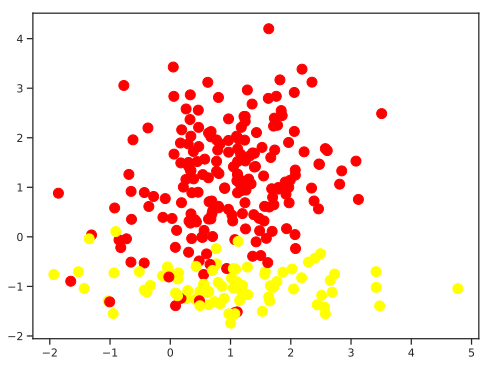

In [296]:
plt.figure(figsize=(8,6))
plt.scatter(map(lambda x: x[0], classification_problem[0]), map(lambda x: x[1], classification_problem[0]), 
              c=classification_problem[1], cmap=colors, s=100)

##### 2.1.2 Разобъем синтезированную выборку на обучение и тест:

In [282]:
train_data, test_data, train_labels, test_labels = train_test_split(classification_problem[0], 
                                                                                     classification_problem[1], 
                                                                                     test_size = 0.3,
                                                                                     stratify=classification_problem[1],
                                                                                     random_state = 1)

##### 2.1.3 Создадим функции, которые проиллюстрирует работу алгоритма:

In [283]:
def get_meshgrid(data, step=.05, border=.5,):
    x_min, x_max = data[:, 0].min() - border, data[:, 0].max() + border
    y_min, y_max = data[:, 1].min() - border, data[:, 1].max() + border
    return np.meshgrid(np.arange(x_min, x_max, step), np.arange(y_min, y_max, step))

In [284]:
def plot_decision_surface(estimator, train_data, train_labels, test_data, test_labels, 
                          colors = colors, light_colors = light_colors):
    #fit model
    estimator.fit(train_data, train_labels)
    
    #set figure size
    plt.figure(figsize = (8, 4))
    
    #plot decision surface on the train data 
    plt.subplot(1,2,1)
    xx, yy = get_meshgrid(train_data)
    mesh_predictions = np.array(estimator.predict(np.c_[xx.ravel(), yy.ravel()])).reshape(xx.shape)
    plt.pcolormesh(xx, yy, mesh_predictions, cmap = light_colors)
    plt.scatter(train_data[:, 0], train_data[:, 1], c = train_labels, s = 100, cmap = colors)
    plt.title('Train data, accuracy={:.2f}'.format(metrics.accuracy_score(train_labels, estimator.predict(train_data))))
    
    #plot decision surface on the test data
    plt.subplot(1,2,2)
    plt.pcolormesh(xx, yy, mesh_predictions, cmap = light_colors)
    plt.scatter(test_data[:, 0], test_data[:, 1], c = test_labels, s = 100, cmap = colors)
    plt.title('Test data, accuracy={:.2f}'.format(metrics.accuracy_score(test_labels, estimator.predict(test_data))))

---

#### 2.2 Решим задачу при помощи LogisticRegression

##### 2.2.1 Построим модель, обучим и посмотрим на качество:

In [285]:
LogR_sin = LogisticRegression()
LogR_sin.fit(train_data, train_labels)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=None, solver='warn',
          tol=0.0001, verbose=0, warm_start=False)

In [146]:
control_error(train_data,train_labels,test_data,test_labels,LogR_sin, all_data=classification_problem[0], all_y = classification_problem[1], k_fold=5, with_graph = False, inf='cross_val_and_large' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.94
                  ROC-AUC on the test: 0.978
                     PR on the test: 0.931

 |------------------------------------------------------------| 

         Estimation of Accuracy by cross validation 0.928
          Estimation of ROC-AUC by cross validation 0.967
         Estimation of average PR by cross validation 0.884

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.932
               Accuracy on 1 class on test: 0.96

 |------------------------------------------------------------| 

                  Accuracy on the train: 0.922
                  ROC-AUC on the train: 0.956

 |------------------------------------------------------------| 

               Accuracy on 0 class on train: 0.92
               Accuracy on 1 class on train: 0.929

 <------------------------------------------------------------

##### 2.2.2 Отрисуем и посмотрим как действовал алгоритм

In [302]:
#закоментил, потому что слишком тяжелый блокнот и не загрузится
plot_decision_surface(LogR_sin, train_data, train_labels, test_data, test_labels)

---

#### 2.3 Решим задачу при помощи XGBoost

In [287]:
XGB_sin = XGBClassifier()
XGB_sin.fit(train_data, train_labels)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='binary:logistic', random_state=0,
       reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
       silent=True, subsample=1)

In [147]:
control_error(train_data,train_labels,test_data,test_labels,XGB_sin, all_data=classification_problem[0], all_y = classification_problem[1], k_fold=5, with_graph = False, inf='cross_val_and_large' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.929
                  ROC-AUC on the test: 0.966
                     PR on the test: 0.888

 |------------------------------------------------------------| 

         Estimation of Accuracy by cross validation 0.913
          Estimation of ROC-AUC by cross validation 0.939
         Estimation of average PR by cross validation 0.89

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.932
               Accuracy on 1 class on test: 0.92

 |------------------------------------------------------------| 

                  Accuracy on the train: 0.969
                  ROC-AUC on the train: 0.998

 |------------------------------------------------------------| 

               Accuracy on 0 class on train: 0.971
               Accuracy on 1 class on train: 0.964

 <-----------------------------------------------------------

##### 2.2.2 Отрисуем и посмотрим как действовал алгоритм

In [300]:
#закоментил, потому что слишком тяжелый блокнот и не загрузится
#plot_decision_surface(XGB_sin, train_data, train_labels, test_data, test_labels)

---

#### 2.4 Решим задачу при помощи нейронной сети:

In [148]:
model_sin = Sequential()
model_sin.add(Dense(15, input_dim=2, activation='relu')) 
model_sin.add(Dense(8, activation='relu'))
model_sin.add(Dense(10, activation='relu'))
model_sin.add(Dense(1, activation='sigmoid'))
 
model_sin.compile(loss="binary_crossentropy", optimizer="adam", metrics=[auc])

history = model_sin.fit(train_data, train_labels, epochs = 50, batch_size=1, verbose=0)

y_pp = model_sin.predict_proba(test_data)

print '\n ROC-AUC on test:',roc_auc_score(test_labels,y_pp)
print ' PR on test:',average_precision_score(test_labels,y_pp)

32/84 [==========>...................] - ETA: 0s
 ROC-AUC on test: 0.9783050847457627
 PR on test: 0.9368458034075736


---

<HTML>
<h2 style='padding: 10px'><center>Оценки предложенных в задаче алгоритмов на синтетической выборке</center></h2>
<table class='table table-striped'>
    <thead style="border:1px solid;"> 
        <tr> 
            <th style="border-right:1px solid;"><center>samples</center></th><th><center><u>LogisticRegression</u><br>average PR</center></th> <th style="border-right:1px solid;"><center><u>LogisticRegression</u><br>ROC-AUC</center></th> <th><center><u>XGBoost</u><br>average PR</center></th> <th style="border-right:1px solid;"><center><u>XGBoost</u><br>ROC-AUC</center></th> <th><center><u>KerasNN</u><br>average PR</center></th><th><center><u>KerasNN</u><br>ROC-AUC</center></th>
        </tr> 
    </thead> 
    <tbody style="border:1px solid;"> 
        <tr> 
            <td style="border-right:1px solid;"><center>Synthetic data</center></td> <td><center>0.884</center></td> <td style="border-right:1px solid;"><center>0.967</center></td> <td><center>0.890</center></td> <td style="border-right:1px solid;"><center>0.939</center></td><td><center>0.937</center></td><td><center>0.976</center></td>  
        </tr>
    <tbody>
</table>

---

### III. Применим алгоритмы на выборках из поставленной задачи

### 3. LogisticRegression

##### 3.1.1 Опробуем и настроим алгоритм на нормализованных данных, без отобранных признаков:


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.729
                  ROC-AUC on the test: 0.727

 |------------------------------------------------------------| 

         Estimation of Accuracy by cross validation 0.704
          Estimation of ROC-AUC by cross validation 0.712
         Estimation of average PR by cross validation 0.553

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.86
               Accuracy on 1 class on test: 0.4

 |------------------------------------------------------------| 

                  Accuracy on the train: 0.744
                  ROC-AUC on the train: 0.761

 |------------------------------------------------------------| 

               Accuracy on 0 class on train: 0.925
               Accuracy on 1 class on train: 0.311

 <------------------------------------------------------------> 



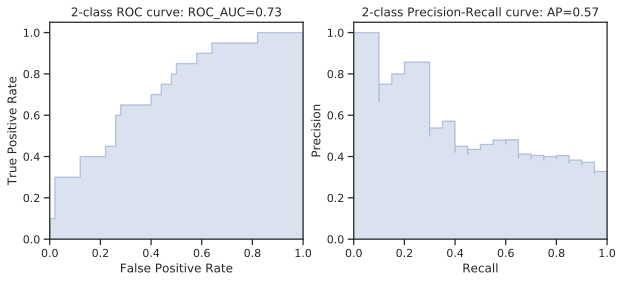

In [42]:
LogR = LogisticRegression(max_iter=20000,C=1)
LogR.fit(X_norm_train,y_train)

control_error(X_norm_train, y_train, X_norm_test, y_test, LogR, all_data=X_norm, all_y = y, k_fold=5, with_graph = True, inf='cross_val_and_large' )

##### 3.1.2 На признаках ['inv-nodes','tumor-size','node-caps','irradiat','deg-malig']:

In [1176]:
LogR = LogisticRegression(max_iter=10000,C=5)
LogR.fit(X_train_1,y_train)

control_error(X_train_1, y_train, X_test_1, y_test, LogR, all_data=X_1, all_y = y, k_fold=5, with_graph = False, inf='cross_val_and_large' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.729
                  ROC-AUC on the test: 0.781

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.74
          Estimation of ROC-AUC by cross validation 0.742
         Estimation of average PR by cross validation 0.56

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.84
               Accuracy on 1 class on test: 0.45

 |------------------------------------------------------------| 

                  Accuracy on the train: 0.734
                  ROC-AUC on the train: 0.741

 |------------------------------------------------------------| 

               Accuracy on 0 class on train: 0.918
               Accuracy on 1 class on train: 0.295

 <------------------------------------------------------------> 



##### 3.1.3 На признаках ['inv-nodes','node-caps','irradiat','deg-malig','menopause_lt40']:

In [1183]:
LogR = LogisticRegression(max_iter=10000,C=1)
LogR.fit(X_train_2,y_train)

control_error(X_train_2, y_train, X_test_2, y_test, LogR, all_data=X_2, all_y = y, k_fold=5, with_graph = False, inf='cross_val_and_large' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.757
                  ROC-AUC on the test: 0.779

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.733
          Estimation of ROC-AUC by cross validation 0.72
         Estimation of average PR by cross validation 0.582

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.88
               Accuracy on 1 class on test: 0.45

 |------------------------------------------------------------| 

                  Accuracy on the train: 0.754
                  ROC-AUC on the train: 0.723

 |------------------------------------------------------------| 

               Accuracy on 0 class on train: 0.932
               Accuracy on 1 class on train: 0.328

 <------------------------------------------------------------> 



##### 3.1.4 На признаках ['tumor-size','inv-nodes','deg-malig','age']:

In [1186]:
LogR = LogisticRegression(max_iter=10000,C=1)
LogR.fit(X_train_3,y_train)

control_error(X_train_3, y_train, X_test_3, y_test, LogR, all_data=X_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val_and_large' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.757
                  ROC-AUC on the test: 0.785

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.729
          Estimation of ROC-AUC by cross validation 0.73
         Estimation of average PR by cross validation 0.597

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.98
               Accuracy on 1 class on test: 0.2

 |------------------------------------------------------------| 

                  Accuracy on the train: 0.725
                  ROC-AUC on the train: 0.727

 |------------------------------------------------------------| 

               Accuracy on 0 class on train: 0.973
               Accuracy on 1 class on train: 0.131

 <------------------------------------------------------------> 



##### 3.1.5 На признаках ['tumor-size','inv-nodes','irradiat','deg-malig','menopause_lt40']:

In [1188]:
LogR = LogisticRegression(max_iter=10000,C=1)
LogR.fit(X_train_4,y_train)

control_error(X_train_4, y_train, X_test_4, y_test, LogR, all_data=X_4, all_y = y, k_fold=5, with_graph = False, inf='cross_val_and_large' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.771
                  ROC-AUC on the test: 0.821

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.722
          Estimation of ROC-AUC by cross validation 0.745
         Estimation of average PR by cross validation 0.587

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.96
               Accuracy on 1 class on test: 0.3

 |------------------------------------------------------------| 

                  Accuracy on the train: 0.72
                  ROC-AUC on the train: 0.736

 |------------------------------------------------------------| 

               Accuracy on 0 class on train: 0.973
               Accuracy on 1 class on train: 0.115

 <------------------------------------------------------------> 



##### 3.1.6 На признаках ['inv-nodes','tumor-size','deg-malig']:

In [1191]:
LogR = LogisticRegression(max_iter=10000,C=1)
LogR.fit(X_train_5,y_train)

control_error(X_train_5, y_train, X_test_5, y_test, LogR, all_data=X_5, all_y = y, k_fold=5, with_graph = False, inf='cross_val_and_large' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.757
                  ROC-AUC on the test: 0.78

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.726
          Estimation of ROC-AUC by cross validation 0.744
         Estimation of average PR by cross validation 0.585

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.96
               Accuracy on 1 class on test: 0.25

 |------------------------------------------------------------| 

                  Accuracy on the train: 0.72
                  ROC-AUC on the train: 0.729

 |------------------------------------------------------------| 

               Accuracy on 0 class on train: 0.979
               Accuracy on 1 class on train: 0.098

 <------------------------------------------------------------> 



##### 3.1.7 На признаках ['inv-nodes','tumor-size','menopause_lt40','deg-malig']:

In [1192]:
LogR = LogisticRegression(max_iter=10000,C=1)
LogR.fit(X_train_6,y_train)

control_error(X_train_6, y_train, X_test_6, y_test, LogR, all_data=X_6, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.757
                  ROC-AUC on the test: 0.781

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.729
          Estimation of ROC-AUC by cross validation 0.745
         Estimation of average PR by cross validation 0.601

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.96
               Accuracy on 1 class on test: 0.25

 <------------------------------------------------------------> 



##### 3.1.8 На признаках ['inv-nodes','tumor-size','age','deg-malig','irradiat']:

In [1194]:
LogR = LogisticRegression(max_iter=10000,C=1)
LogR.fit(X_train_7,y_train)

control_error(X_train_7, y_train, X_test_7, y_test, LogR, all_data=X_7, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.825

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.725
          Estimation of ROC-AUC by cross validation 0.742
         Estimation of average PR by cross validation 0.59

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.3

 <------------------------------------------------------------> 



##### 3.1.9 На признаках ['inv-nodes','node-caps','age','deg-malig','irradiat']:

In [1197]:
LogR = LogisticRegression(max_iter=10000,C=1)
LogR.fit(X_train_8,y_train)

control_error(X_train_8, y_train, X_test_8, y_test, LogR, all_data=X_8, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.78

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.754
          Estimation of ROC-AUC by cross validation 0.729
         Estimation of average PR by cross validation 0.57

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.88
               Accuracy on 1 class on test: 0.4

 <------------------------------------------------------------> 



#### 3.2 Настроим алгоритм на данных, полученных методом понижения размерности:

##### 3.2.1 TSN-e до 2 признаков:

In [1202]:
LogR = LogisticRegression(max_iter=10000,C=1)

LogR.fit(X_TSNE_2_selectively_train,y_for_reduced_dimension_train)

control_error(X_TSNE_2_selectively_train, y_for_reduced_dimension_train , X_TSNE_2_selectively_test, y_for_reduced_dimension_test, LogR, all_data=X_TSNE_2_selectively, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.757
                  ROC-AUC on the test: 0.704

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.707
          Estimation of ROC-AUC by cross validation 0.722
         Estimation of average PR by cross validation 0.535

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.9
               Accuracy on 1 class on test: 0.4

 <------------------------------------------------------------> 



##### 3.2.2 TSN-e до 3 признаков:

In [1207]:
LogR = LogisticRegression(max_iter=10000,C=1)

LogR.fit(X_TSNE_3_train,y_for_reduced_dimension_train)

control_error(X_TSNE_3_train, y_for_reduced_dimension_train , X_TSNE_3_test, y_for_reduced_dimension_test, LogR, all_data=X_TSNE_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.7
                  ROC-AUC on the test: 0.587

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.704
          Estimation of ROC-AUC by cross validation 0.538
         Estimation of average PR by cross validation 0.356

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.15

 <------------------------------------------------------------> 



##### 3.2.3 PCA до 2 признаков:

In [1209]:
LogR = LogisticRegression(max_iter=10000,C=1)

LogR.fit(X_PCA_2_selectively_train,y_for_reduced_dimension_train)

control_error(X_PCA_2_selectively_train, y_for_reduced_dimension_train , X_PCA_2_selectively_test, y_for_reduced_dimension_test, LogR, all_data=X_PCA_2_selectively, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.757
                  ROC-AUC on the test: 0.79

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.74
          Estimation of ROC-AUC by cross validation 0.752
         Estimation of average PR by cross validation 0.578

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.35

 <------------------------------------------------------------> 



##### 3.2.4 PCA на до 3 признаков:

In [1211]:
LogR = LogisticRegression(max_iter=10000,C=1)

LogR.fit(X_PCA_3_train,y_for_reduced_dimension_train)

control_error(X_PCA_3_train, y_for_reduced_dimension_train , X_PCA_3_test, y_for_reduced_dimension_test, LogR, all_data=X_PCA_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.775

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.719
          Estimation of ROC-AUC by cross validation 0.703
         Estimation of average PR by cross validation 0.557

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.3

 <------------------------------------------------------------> 



##### 3.2.5 PCA до 4 признаков:

In [1213]:
LogR = LogisticRegression(max_iter=10000,C=1)

LogR.fit(X_PCA_4_train,y_for_reduced_dimension_train)

control_error(X_PCA_4_train, y_for_reduced_dimension_train , X_PCA_4_test, y_for_reduced_dimension_test, LogR, all_data=X_PCA_4, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.743
                  ROC-AUC on the test: 0.75

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.718
          Estimation of ROC-AUC by cross validation 0.71
         Estimation of average PR by cross validation 0.559

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.3

 <------------------------------------------------------------> 



##### 3.2.6 PCA до 5 признаков:

In [1217]:
LogR = LogisticRegression(max_iter=10000,C=1)

LogR.fit(X_PCA_5_train,y_for_reduced_dimension_train)

control_error(X_PCA_5_train, y_for_reduced_dimension_train , X_PCA_5_test, y_for_reduced_dimension_test, LogR, all_data=X_PCA_5, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.771
                  ROC-AUC on the test: 0.749

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.723
          Estimation of ROC-AUC by cross validation 0.672
         Estimation of average PR by cross validation 0.556

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.4

 <------------------------------------------------------------> 



---

### 4. XGBoost

##### 4.1.1 Опробуем и настроим алгоритм на нормализованных данных, без отобранных признаков:


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.771
                  ROC-AUC on the test: 0.732
                     PR on the test: 0.655

 |------------------------------------------------------------| 

         Estimation of Accuracy by cross validation 0.715
          Estimation of ROC-AUC by cross validation 0.709
         Estimation of average PR by cross validation 0.465

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.4

 |------------------------------------------------------------| 

                  Accuracy on the train: 0.874
                  ROC-AUC on the train: 0.933

 |------------------------------------------------------------| 

               Accuracy on 0 class on train: 0.959
               Accuracy on 1 class on train: 0.672

 <------------------------------------------------------------

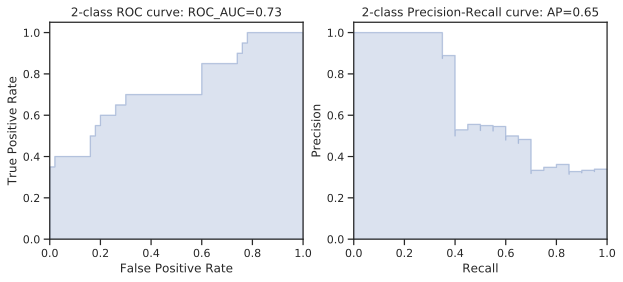

In [45]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)
XGB.fit(X_norm_train,y_train)

control_error(X_norm_train, y_train, X_norm_test, y_test, XGB, all_data=X_norm, all_y = y, k_fold=5, with_graph = True, inf='cross_val_and_large' )

##### 4.1.2 На признаках ['inv-nodes','tumor-size','node-caps','irradiat','deg-malig']:

In [1257]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)
XGB.fit(X_train_1,y_train)

control_error(X_train_1, y_train, X_test_1, y_test, XGB, all_data=X_1, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.8
                  ROC-AUC on the test: 0.751

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.733
          Estimation of ROC-AUC by cross validation 0.695
         Estimation of average PR by cross validation 0.548

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.88
               Accuracy on 1 class on test: 0.6

 <------------------------------------------------------------> 



##### 4.1.3 На признаках ['inv-nodes','node-caps','irradiat','deg-malig','menopause_lt40']:

In [1258]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)
XGB.fit(X_train_2,y_train)

control_error(X_train_2, y_train, X_test_2, y_test, XGB, all_data=X_2, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.757
                  ROC-AUC on the test: 0.775

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.769
          Estimation of ROC-AUC by cross validation 0.674
         Estimation of average PR by cross validation 0.549

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.35

 <------------------------------------------------------------> 



##### 4.1.4 На признаках ['tumor-size','inv-nodes','deg-malig','age']:

In [1266]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)
XGB.fit(X_train_3,y_train)

control_error(X_train_3, y_train, X_test_3, y_test, XGB, all_data=X_2, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.8
                  ROC-AUC on the test: 0.764

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.765
          Estimation of ROC-AUC by cross validation 0.685
         Estimation of average PR by cross validation 0.555

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.94
               Accuracy on 1 class on test: 0.45

 <------------------------------------------------------------> 



##### 4.1.5 На признаках ['tumor-size','inv-nodes','irradiat','deg-malig','menopause_lt40']:

In [1268]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)
XGB.fit(X_train_4,y_train)

control_error(X_train_4, y_train, X_test_4, y_test, XGB, all_data=X_4, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.8
                  ROC-AUC on the test: 0.755

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.748
          Estimation of ROC-AUC by cross validation 0.704
         Estimation of average PR by cross validation 0.568

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.88
               Accuracy on 1 class on test: 0.6

 <------------------------------------------------------------> 



##### 4.1.6 На признаках ['inv-nodes','tumor-size','deg-malig']:

In [1272]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)
XGB.fit(X_train_5,y_train)

control_error(X_train_5, y_train, X_test_5, y_test, XGB, all_data=X_5, all_y = y, k_fold=5, with_graph = False, inf='cross_val_and_large' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.8
                  ROC-AUC on the test: 0.762

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.74
          Estimation of ROC-AUC by cross validation 0.683
         Estimation of average PR by cross validation 0.602

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.94
               Accuracy on 1 class on test: 0.45

 |------------------------------------------------------------| 

                  Accuracy on the train: 0.778
                  ROC-AUC on the train: 0.803

 |------------------------------------------------------------| 

               Accuracy on 0 class on train: 0.966
               Accuracy on 1 class on train: 0.328

 <------------------------------------------------------------> 



##### 4.1.7 На признаках ['inv-nodes','tumor-size','menopause_lt40','deg-malig']:

In [1274]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)
XGB.fit(X_train_6,y_train)

control_error(X_train_6, y_train, X_test_6, y_test, XGB, all_data=X_6, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.8
                  ROC-AUC on the test: 0.762

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.762
          Estimation of ROC-AUC by cross validation 0.699
         Estimation of average PR by cross validation 0.565

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.94
               Accuracy on 1 class on test: 0.45

 <------------------------------------------------------------> 



##### 4.1.8 На признаках ['inv-nodes','tumor-size','age','deg-malig','irradiat']:

In [1278]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)
XGB.fit(X_train_7,y_train)

control_error(X_train_7, y_train, X_test_7, y_test, XGB, all_data=X_7, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.757
                  ROC-AUC on the test: 0.77

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.729
          Estimation of ROC-AUC by cross validation 0.715
         Estimation of average PR by cross validation 0.52

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.86
               Accuracy on 1 class on test: 0.5

 <------------------------------------------------------------> 



##### 4.1.9 На признаках ['inv-nodes','node-caps','age','deg-malig','irradiat']:

In [1282]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)
XGB.fit(X_train_8,y_train)

control_error(X_train_8, y_train, X_test_8, y_test, XGB, all_data=X_8, all_y = y, k_fold=5, with_graph = False, inf='cross_val' )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.786
                  ROC-AUC on the test: 0.764

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.755
          Estimation of ROC-AUC by cross validation 0.652
         Estimation of average PR by cross validation 0.578

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.92
               Accuracy on 1 class on test: 0.45

 <------------------------------------------------------------> 



#### 4.2 Настроим алгоритм на данных, полученных методом понижения размерности:

##### 4.2.1 TSN-e на до 2 признаков:

In [1284]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)

XGB.fit(X_TSNE_2_selectively_train,y_for_reduced_dimension_train)

control_error(X_TSNE_2_selectively_train, y_for_reduced_dimension_train , X_TSNE_2_selectively_test, y_for_reduced_dimension_test, XGB, all_data=X_TSNE_2_selectively, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.714
                  ROC-AUC on the test: 0.667

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.712
          Estimation of ROC-AUC by cross validation 0.705
         Estimation of average PR by cross validation 0.505

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.86
               Accuracy on 1 class on test: 0.35

 <------------------------------------------------------------> 



##### 4.4.2 TSN-e до 3 признаков:

In [1293]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)

XGB.fit(X_TSNE_3_train,y_for_reduced_dimension_train)

control_error(X_TSNE_3_train, y_for_reduced_dimension_train , X_TSNE_3_test, y_for_reduced_dimension_test, XGB, all_data=X_TSNE_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.629
                  ROC-AUC on the test: 0.594

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.675
          Estimation of ROC-AUC by cross validation 0.55
         Estimation of average PR by cross validation 0.409

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.78
               Accuracy on 1 class on test: 0.25

 <------------------------------------------------------------> 



##### 4.4.3 PCA до 2 признаков:

In [1295]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)

XGB.fit(X_PCA_2_selectively_train,y_for_reduced_dimension_train)

control_error(X_PCA_2_selectively_train, y_for_reduced_dimension_train , X_PCA_2_selectively_test, y_for_reduced_dimension_test, XGB, all_data=X_PCA_2_selectively, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.657
                  ROC-AUC on the test: 0.596

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.766
          Estimation of ROC-AUC by cross validation 0.704
         Estimation of average PR by cross validation 0.564

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.86
               Accuracy on 1 class on test: 0.15

 <------------------------------------------------------------> 



##### 4.4.4 PCA до 3 признаков:

In [1297]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)

XGB.fit(X_PCA_3_train,y_for_reduced_dimension_train)

control_error(X_PCA_3_train, y_for_reduced_dimension_train , X_PCA_3_test, y_for_reduced_dimension_test, XGB, all_data=X_PCA_3, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.686
                  ROC-AUC on the test: 0.626

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.718
          Estimation of ROC-AUC by cross validation 0.713
         Estimation of average PR by cross validation 0.558

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.88
               Accuracy on 1 class on test: 0.2

 <------------------------------------------------------------> 



##### 4.4.5 PCA до 4 признаков:

In [1299]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)

XGB.fit(X_PCA_4_train,y_for_reduced_dimension_train)

control_error(X_PCA_4_train, y_for_reduced_dimension_train , X_PCA_4_test, y_for_reduced_dimension_test, XGB, all_data=X_PCA_4, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.714
                  ROC-AUC on the test: 0.667

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.739
          Estimation of ROC-AUC by cross validation 0.7
         Estimation of average PR by cross validation 0.543

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.9
               Accuracy on 1 class on test: 0.25

 <------------------------------------------------------------> 



##### 4.4.6 PCA до 5 признаков:

In [1304]:
XGB = XGBClassifier(eta=0.3,max_depth=3,subsample=0.9)

XGB.fit(X_PCA_5_train,y_for_reduced_dimension_train)

control_error(X_PCA_5_train, y_for_reduced_dimension_train , X_PCA_5_test, y_for_reduced_dimension_test, XGB, all_data=X_PCA_5, all_y = y, k_fold=5, with_graph = False, inf='cross_val'  )


 <------------------------------------------------------------> 

                  Accuracy on the test: 0.757
                  ROC-AUC on the test: 0.71

 |------------------------------------------------------------| 

          Estimation of Accuracy by cross validation 0.722
          Estimation of ROC-AUC by cross validation 0.698
         Estimation of average PR by cross validation 0.547

 |------------------------------------------------------------| 

               Accuracy on 0 class on test: 0.98
               Accuracy on 1 class on test: 0.2

 <------------------------------------------------------------> 



### 5. Многослойная нейронная сеть

##### 5.1.1 Опробуем и настроим алгоритм на нормализованных данных, без отобранных признаков:

In [248]:
model = Sequential()
model.add(Dense(15, input_dim=15, activation='relu')) 
model.add(Dense(8, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_norm_train), np.array(y_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_norm_test))

print '\n ROC-AUC on test:',round(roc_auc_score(y_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.709
 PR on test: 0.559


##### 5.1.2 На признаках ['inv-nodes','tumor-size','node-caps','irradiat','deg-malig']:

In [249]:
model = Sequential()
model.add(Dense(15, input_dim=5, activation='relu')) 
model.add(Dense(8, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_train_1), np.array(y_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_test_1))

print '\n ROC-AUC on test:',round(roc_auc_score(y_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.782
 PR on test: 0.639


##### 5.1.3 На признаках ['inv-nodes','node-caps','irradiat','deg-malig','menopause_lt40']:

In [250]:
model = Sequential()
model.add(Dense(15, input_dim=5, activation='relu')) 
model.add(Dense(8, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_train_2), np.array(y_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_test_2))

print '\n ROC-AUC on test:',round(roc_auc_score(y_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.845
 PR on test: 0.64


##### 5.1.4 На признаках ['tumor-size','inv-nodes','deg-malig','age']:

In [251]:
model = Sequential()
model.add(Dense(15, input_dim=4, activation='relu')) 
model.add(Dense(8, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_train_3), np.array(y_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_test_3))

print '\n ROC-AUC on test:',round(roc_auc_score(y_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.798
 PR on test: 0.659


##### 5.1.5 На признаках ['tumor-size','inv-nodes','irradiat','deg-malig','menopause_lt40']:

In [252]:
model = Sequential()
model.add(Dense(15, input_dim=5, activation='relu')) 
model.add(Dense(8, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid')) 
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_train_4), np.array(y_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_test_4))

print '\n ROC-AUC on test:',round(roc_auc_score(y_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.752
 PR on test: 0.597


##### 5.1.6 На признаках ['inv-nodes','tumor-size','deg-malig']:

In [253]:
model = Sequential()
model.add(Dense(15, input_dim=3, activation='relu')) 
model.add(Dense(8, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_train_5), np.array(y_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_test_5))

print '\n ROC-AUC on test:',round(roc_auc_score(y_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.79
 PR on test: 0.635


##### 5.1.7 На признаках ['inv-nodes','tumor-size','menopause_lt40','deg-malig']:

In [254]:
model = Sequential()
model.add(Dense(15, input_dim=4, activation='relu')) 
model.add(Dense(8, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_train_6), np.array(y_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_test_6))

print '\n ROC-AUC on test:',round(roc_auc_score(y_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.767
 PR on test: 0.619


##### 5.1.8 На признаках ['inv-nodes','tumor-size','age','deg-malig','irradiat']:

In [255]:
model = Sequential()
model.add(Dense(15, input_dim=5, activation='relu')) 
model.add(Dense(8, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_train_7), np.array(y_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_test_7))

print '\n ROC-AUC on test:',round(roc_auc_score(y_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.78
 PR on test: 0.59


##### 5.1.9 На признаках ['inv-nodes','node-caps','age','deg-malig','irradiat']:

In [256]:
model = Sequential()
model.add(Dense(15, input_dim=5, activation='relu')) 
model.add(Dense(8, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_train_8), np.array(y_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_test_8))

print '\n ROC-AUC on test:',round(roc_auc_score(y_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.808
 PR on test: 0.618


#### 5.2 Настроим алгоритм на данных, полученных методом понижения размерности:

##### 5.2.1 TSN-e до 2 признаков:

In [257]:
model = Sequential()
model.add(Dense(15, input_dim=2, activation='relu')) 
model.add(Dense(8, activation='relu'))
model.add(Dense(1, activation='sigmoid')) 
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_TSNE_2_selectively_train), np.array(y_for_reduced_dimension_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_TSNE_2_selectively_test))

print '\n ROC-AUC on test:',round(roc_auc_score(y_for_reduced_dimension_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_for_reduced_dimension_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.394
 PR on test: 0.27


##### 5.2.2 TSN-e до 3 признаков:

In [258]:
model = Sequential()
model.add(Dense(15, input_dim=3, activation='relu')) 
model.add(Dense(4, activation='relu'))
model.add(Dense(1, activation='sigmoid')) 
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_TSNE_3_train), np.array(y_for_reduced_dimension_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_TSNE_3_test))

print '\n ROC-AUC on test:',round(roc_auc_score(y_for_reduced_dimension_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_for_reduced_dimension_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.455
 PR on test: 0.303


##### 5.2.3 PCA до 2 признаков:

In [259]:
model = Sequential()
model.add(Dense(15, input_dim=2, activation='relu')) 
model.add(Dense(3, activation='relu'))
model.add(Dense(2, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_PCA_2_selectively_train), np.array(y_for_reduced_dimension_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_PCA_2_selectively_test))

print '\n ROC-AUC on test:',round(roc_auc_score(y_for_reduced_dimension_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_for_reduced_dimension_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.766
 PR on test: 0.574


##### 5.2.4 PCA до 3 признаков:

In [260]:
model = Sequential()
model.add(Dense(15, input_dim=3, activation='relu')) 
model.add(Dense(9, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])

history = model.fit(np.array(X_PCA_3_train), np.array(y_for_reduced_dimension_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_PCA_3_test))

print '\n ROC-AUC on test:',round(roc_auc_score(y_for_reduced_dimension_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_for_reduced_dimension_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.59
 PR on test: 0.358


##### 5.2.5 PCA до 4 признаков:

In [261]:
model = Sequential()
model.add(Dense(15, input_dim=4, activation='relu')) 
model.add(Dense(3, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])
history = model.fit(np.array(X_PCA_4_train), np.array(y_for_reduced_dimension_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_PCA_4_test))

print '\n ROC-AUC on test:',round(roc_auc_score(y_for_reduced_dimension_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_for_reduced_dimension_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.643
 PR on test: 0.403


##### 5.2.6 PCA до 5 признаков:

In [262]:
model = Sequential()
model.add(Dense(15, input_dim=5, activation='relu')) 
model.add(Dense(8, activation='relu'))
model.add(Dense(10, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
 
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])
history = model.fit(np.array(X_PCA_5_train), np.array(y_for_reduced_dimension_train), epochs = 200, batch_size=1, verbose=0)

y_pp = model.predict_proba(np.array(X_PCA_5_test))

print '\n ROC-AUC on test:',round(roc_auc_score(y_for_reduced_dimension_test,y_pp),3)
print ' PR on test:',round(average_precision_score(y_for_reduced_dimension_test,y_pp),3)

32/70 [============>.................] - ETA: 1s
 ROC-AUC on test: 0.711
 PR on test: 0.552


## Итог работы предложенных моделей:

<HTML>
<h2 style='padding: 10px'><center>Оценки предложенных в задаче алгоритмов</center></h2>
<table class='table table-striped'>
    <thead style="border:1px solid;"> 
        <tr> 
            <th style="border-right:1px solid;"><center>samples</center></th><th><center><u>LogisticRegression</u><br>ROC-AUC</center></th> <th style="border-right:1px solid;"><center><u>LogisticRegression</u><br>average PR</center></th> <th><center><u>XGBoost</u><br>ROC-AUC</center></th> <th style="border-right:1px solid;"><center><u>XGBoost</u><br>average PR</center></th> <th><center><u>KerasNN</u><br>ROC-AUC</center></th><th><center><u>KerasNN</u><br>average PR</center></th>
        </tr> 
    </thead> 
    <tbody style="border:1px solid;"> 
        <tr> 
            <td style="border-right:1px solid;"><center>X</center></td> <td><center>0.712</center></td> <td style="border-right:1px solid;"><center>0.553</center></td> <td style='background-color:PaleGreen;'><center>0.709</center></td> <td style="border-right:1px solid;"><center>0.465</center></td><td><center>0.712</center></td><td><center>0.595</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_1</center></td> <td><center>0.742</center></td> <td style="border-right:1px solid;"><center>0.560</center></td> <td><center>0.695</center></td> <td style="border-right:1px solid;"><center>0.548</center></td><td><center>0.772</center></td><td><center>0.627</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_2</center></td> <td><center>0.720</center></td> <td style="border-right:1px solid;"><center>0.582</center></td> <td><center>0.674</center></td> <td style="border-right:1px solid;"><center>0.549</center></td><td style='background-color:ForestGreen;color:white'><center>0.818</center></td><td><center>0.615</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_3</center></td> <td><center>0.730</center></td> <td style="border-right:1px solid; background-color:Goldenrod;color:white;"><center>0.597</center></td> <td><center>0.685</center></td> <td style="border-right:1px solid;"><center>0.555</center></td><td><center>0.770</center></td><td><center>0.620</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_4</center></td> <td style='background-color:LimeGreen;color:white'><center>0.745</center></td> <td style="border-right:1px solid;"><center>0.587</center></td> <td><center>0.704</center></td> <td style="border-right:1px solid;background-color:Khaki"><center>0.568</center></td><td><center>0.767</center></td><td style="background-color:Khaki"><center>0.633</center></td>  
        </tr>
        <tr> 
                <td style="border-right:1px solid;"><center>X_5</center></td> <td style="background-color:PaleGreen"><center>0.744</center></td> <td style="border-right:1px solid;"><center>0.585</center></td> <td><center>0.683</center></td> <td style="border-right:1px solid;background-color:DarkGoldenRod;color:white"><center>0.605</center></td><td><center>0.788</center></td><td style="background-color:Goldenrod;color:white"><center>0.644</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_6</center></td> <td><center>0.705</center></td> <td style="border-right:1px solid;background-color:DarkGoldenRod;color:white;"><center>0.601</center></td> <td><center>0.699</center></td> <td style="border-right:1px solid;"><center>0.565</center></td><td><center>0.781</center></td><td style='background-color:DarkGoldenRod;color:white'><center>0.675</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_7</center></td> <td style='background-color:LimeGreen;color:white;'><center>0.745</center></td> <td style="border-right:1px solid;background-color:Khaki"><center>0.590</center></td> <td style='background-color:ForestGreen;color:white'><center>0.715</center></td> <td style="border-right:1px solid;"><center>0.520</center></td><td style="background-color:PaleGreen"><center>0.792</center></td><td><center>0.618</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_8</center></td> <td><center>0.729</center></td> <td style="border-right:1px solid;"><center>0.570</center></td> <td><center>0.652</center></td> <td style="border-right:1px solid;background-color:Goldenrod;color:white;"><center>0.578</center></td><td style="background-color:LimeGreen;color:white"><center>0.796</center></td><td><center>0.617</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_t-SNE_2</center></td> <td><center>0.722</center></td> <td style="border-right:1px solid;"><center>0.535</center></td> <td><center>0.705</center></td> <td style="border-right:1px solid;"><center>0.545</center></td><td><center>0.362</center></td><td><center>0.254</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_t-SNE_3</center></td> <td><center>0.538</center></td> <td style="border-right:1px solid;"><center>0.356</center></td> <td><center>0.550</center></td> <td style="border-right:1px solid;"><center>0.495</center></td><td><center>0.518</center></td><td><center>0.324</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_PCA_2</center></td> <td style ='background-color:ForestGreen;color:white'><center>0.752</center></td> <td style="border-right:1px solid;"><center>0.578</center></td> <td><center>0.704</center></td> <td style="border-right:1px solid;"><center>0.564</center></td><td><center>0.680</center></td><td><center>0.458</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_PCA_3</center></td> <td><center>0.704</center></td> <td style="border-right:1px solid;"><center>0.557</center></td> <td style="background-color:LimeGreen;color:white"><center>0.713</center></td> <td style="border-right:1px solid;"><center>0.558</center></td><td><center>0.624</center></td><td><center>0.383</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_PCA_4</center></td> <td><center>0.710</center></td> <td style="border-right:1px solid;"><center>0.559</center></td> <td><center>0.700</center></td> <td style="border-right:1px solid;"><center>0.543</center></td><td><center>0.686</center></td><td><center>0.468</center></td>  
        </tr>
        <tr> 
            <td style="border-right:1px solid;"><center>X_PCA_5</center></td> <td><center>0.672</center></td> <td style="border-right:1px solid;"><center>0.556</center></td> <td><center>0.698</center></td> <td style="border-right:1px solid;"><center>0.547</center></td><td><center>0.676</center></td><td><center>0.535</center></td>  
        </tr>
    <tbody>
</table>
    
*Чем темнее фон, тем выше оценка качества алгоритма

## Вывод по работе:

$\textbf{Лучшая оценка по метрике ROC-AUC:}$  
* 0.818 получена связной нейронной сетью на признаках inv-nodes, node-caps, irradiat, deg-malig, menopause\_lt40


$\textbf{Лучшая оценка по метрике average PR:}$
* 0.675 получена связной нейронной сетью на признаках inv-nodes, tumor-size, menopause\_lt40, deg-malig;

Наиболее информативными предположительно являются признаки: **tumor-size**, **inv-nodes**, **deg-malig**, **age**, **irradiat**. 